# `l2hmc`: Example

<a href="https://arxiv.org/abs/2105.03418"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2105.03418-B31B1B.svg" align="left"></a> <a href="https://arxiv.org/abs/2112.01582"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2112.01582-B31B1B.svg" align="left" style="margin-left:10px;"></a><br>


This notebook will (attempt) to walk through the steps needed to successfully instantiate and "run" an experiment.

For this example, we wish to train the L2HMC sampler for the 2D $U(1)$ lattice gauge model with Wilson action:

$$
S_{\beta}(n) = \beta \sum_{n}\sum_{\mu<\nu}\mathrm{Re}\left[1 - U_{\mu\nu}(n) \right]
$$

This consists of the following steps:
  1. Build an `Experiment` by parsing our configuration object
  2. Train our model using the `Experiment.train()` method
  3. Evaluate our trained model `Experiment.evaluate(job_type='eval')`
  4. Compare our trained models' performance against generic HMC `Experiment.evaluate(job_type='hmc')`
  

<div class="alert alert-block alert-info" style="background:rgba(102, 102, 102, 0.1);color:#666666; border-radius:5px; border: none;">
<span style="font-weight:700; font-size:1.5em;">Evaluating Performance</span>
    
Explicitly, we measure the performance of our model by comparing the _tunneling rate_ $\delta Q$ of our **trained** sampler to that of generic HMC.
    
Explicitly, the tunneling rate is given by:
    
$$
\delta Q = \frac{1}{N_{\mathrm{chains}}}\sum_{\mathrm{chains}} \left|Q_{i+1} - Q_{i}\right|
$$
    
where the difference is between subsequent states in a chain, and the sum is over all $N$ chains (each being ran in parallel, _independently_).
    
Since our goal is to generate _independent configurations_, the more our sampler tunnels between different topological sectors (_tunneling rate_), the more efficient our sampler.
    
</div>


## Imports / Setup

In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib widget

import os
import warnings

warnings.filterwarnings('ignore')
os.environ['TORCH_CPP_LOG_LEVEL'] = 'ERROR'
os.environ['AUTOGRAPH_VERBOSITY'] = '10'
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
!echo $CUDA_VISIBLE_DEVICES

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
0


In [3]:
from __future__ import absolute_import, print_function, annotations, division

import logging
from rich.style import Style
from rich.console import Console
from rich.logging import RichHandler
from l2hmc.utils.rich import get_console
from l2hmc.utils.plot_helpers import set_plot_style
from l2hmc.main import build_experiment

import matplotlib.pyplot as plt
import seaborn as sns
from l2hmc.utils.plot_helpers import set_plot_style

set_plot_style()
plt.rcParams['grid.alpha'] = 0.8
plt.rcParams['grid.color'] = '#404040'
sns.set(rc={"figure.dpi":100, 'savefig.dpi':300})
sns.set_context('notebook')
sns.set_style("ticks")
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')

console = get_console()
print(console.is_jupyter)

log = logging.getLogger()

handler = RichHandler(
    rich_tracebacks=True,
    tracebacks_show_locals=True,
    console=console,
    show_path=False,
    log_time_format='[%H:%m:%S]',
    enable_link_path=False,
)

log.handlers = [handler]

log.setLevel('INFO')

tlog = logging.getLogger('torch')
tlog.setLevel('ERROR')

wblog = logging.getLogger('wandb')
wblog.setLevel('CRITICAL')

--------------------------------------------------------------------------

  Local host:   thetagpu23
  Local device: mlx5_0
--------------------------------------------------------------------------


True


# Initialize and Build `Experiment` objects:

- The `l2hmc.main` module provides a function `build_experiment`:

```python
def build_experiment(overrides: list[str]) -> tfExperiment | ptExperiment:
    ...
```

which will:

1. Load the default options from `conf/config.yaml`
2. Override the default options with any values provided in `overrides`
3. Parse these options and build an `ExperimentConfig` which uniquely defines an experiment
3. Instantiate / return an `Experiment` from the `ExperimentConfig`.
   Depending on `framework=pytorch|tensorflow`:
    a. `framework=pytorch` -> `l2hmc.experiment.pytorch.Experiment`
    b. `framework=tensorflow` -> `l2hmc.experiment.tensorflow.Experiment`

```python
>>> train_output = experiment.train()
>>> eval_output = experiment.evaluate(job_type='eval')
>>> hmc_output = experiment.evaluate(job_type='hmc')
```

<div class="alert alert-block alert-info" style="background:rgba(102, 102, 102, 0.2);color:rgb(102,102,102); border-radius:5px; border:none">
<b><u>Overriding Defaults</u></b>

Specifics about the training / evaluation / hmc runs can be flexibly overridden by passing arguments to the training / evaluation / hmc runs, respectively
</div>

In [4]:
import numpy as np

seed = np.random.randint(1)

defaults = [
    # =========================== # DEFAULT ARGUMENTS ===========================
    f'seed={seed}',               # random seed
    'init_aim=false',             # turn off aim metric tracking
    'init_wandb=false',           # turn off W&B for notebook example
    # --------------------------------------------------------------------------
    'dynamics.nleapfrog=10',      # num leapfrog steps (layers)
    'dynamics.nchains=4096',      # x.shape: [nchains, *lattice_shape]
    # --------------------------------------------------------------------------
    'conv=none',                  # simple example, no conv net
    'network.units=[16, 32, 64]', # size of inner dense layers in Leapfrog Layer
    # --------------------------------------------------------------------------
    'steps.log=20',               # how frequently to log metrics (training)
    'steps.print=1000',           # how frequently to print metrics (training)
    'steps.nepoch=5000',          # how many train steps to take @ each β
    # --------------------------------------------------------------------------
    'annealing_schedule.beta_init=4.0',     # start of annealing schedule: β₀
    'annealing_schedule.beta_final=5.0',    # end of annealing schedule: β₁
    # --------------------------------------------------------------------------
]

outputs = {
    'pytorch': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
    'tensorflow': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
}

In [5]:
# Build PyTorch Experiment
ptExpU1 = build_experiment(
    overrides=[
        *defaults,
        'framework=pytorch',
        'backend=DDP',
        'precision=fp16',
    ]
)

[10:02:07] INFO     Global Rank: 0 / 0

[10:02:23] INFO     Caught MASTER_PORT:2345 from environment!

           INFO     Caught MASTER_PORT:2345 from environment!

           WARNING  Using torch.float16 on cuda!

[10:02:27] INFO     Looking for checkpoints in:                                              
                     /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/projects/l2hmc-qcd
                    /src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/sepnets-True/merge-T
                    rue/net-16-32-64_dp-0.2_bn-False/pytorch

           WARNING  No checkpoints found to load from

           WARNING  Restoring global step from ckpt! self._gstep: 0

           WARNING  Using `torch.optim.Adam` optimizer

In [6]:
# Build TensorFlow Experiment

import tensorflow as tf

tf.keras.mixed_precision.set_global_policy('mixed_float16')

tfExpU1 = build_experiment(
    overrides=[
        *defaults,
        'framework=tensorflow',
        'backend=horovod',
        'precision=fp16',
    ]
)

           INFO     Mixed precision compatibility check (mixed_float16): OK                  
                    Your GPU will likely run quickly with dtype policy mixed_float16 as it   
                    has compute capability of at least 7.0. Your GPU: NVIDIA A100-SXM4-80GB, 
                    compute capability 8.0

[10:02:30] INFO     1, Physical GPUs and 1 Logical GPUs

           WARNING  Using: float32 precision

           INFO     RANK: 0, LOCAL_RANK: 0

## PyTorch

### Training

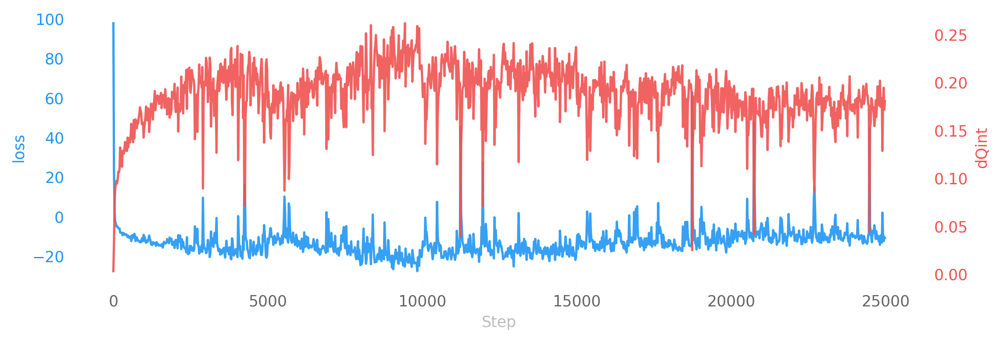

[10:02:39] INFO     [TRAINING] x.dtype: torch.float32

           INFO     [TRAINING] self._dtype: torch.float16

           INFO     ┏━━━━━━━━━━━━━━━━━━━━━━━━━┓

           INFO     ┃ ERA: 0 / 5, BETA: 4.000 ┃

           INFO     ┗━━━━━━━━━━━━━━━━━━━━━━━━━┛

[10:02:43] INFO     Thermalizing configs @ 4.00 took 4.4271 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

           WARNING  [TRAINING] x.dtype: torch.float16

           WARNING  [TRAINING] x.device: cuda:0

[10:02:44] INFO     era=0   epoch=0   tstep=1   dt=0.5281 beta=4.0000 loss=97.7404           
                    dQsin=0.0024 dQint=0.0032 energy=405.5656 logprob=405.9646 logdet=-0.3990
                    sldf=-0.1408 sldb=-0.2598 sldfb=-0.3990 sld=-0.3990 xeps=0.1000          
                    veps=0.1000 acc=0.0014 sumlogdet=-0.0002 acc_mask=0.0012 plaqs=0.8633    
                    intQ=-0.0127 sinQ=-0.0129 lr=0.0010

[10:02:05] INFO     era=0   epoch=1000 tstep=1001 dt=0.3108 beta=4.0000 loss=-10.2810        
                    dQsin=0.2038 dQint=0.1525 energy=399.7085 logprob=398.5443 logdet=1.1642 
                    sldf=0.6342 sldb=-0.4904 sldfb=1.1642 sld=1.1642 xeps=0.1152 veps=0.0964 
                    acc=0.4887 sumlogdet=0.0002 acc_mask=0.4797 plaqs=0.8633 intQ=-0.0360    
                    sinQ=-0.0282 lr=0.0010

[10:02:34] INFO     era=0   epoch=2000 tstep=2001 dt=0.3103 beta=4.0000 loss=-13.1331        
                    dQsin=0.2039 dQint=0.1764 energy=402.6596 logprob=400.4608 logdet=2.1988 
                    sldf=1.2065 sldb=-1.1353 sldfb=2.1988 sld=2.1988 xeps=0.1400 veps=0.1118 
                    acc=0.4068 sumlogdet=0.0045 acc_mask=0.4038 plaqs=0.8633 intQ=0.0022     
                    sinQ=0.0061 lr=0.0010

[10:02:03] INFO     era=0   epoch=3000 tstep=3001 dt=0.3116 beta=4.0000 loss=-18.4613        
                    dQsin=0.2360 dQint=0.2256 energy=405.0707 logprob=401.5802 logdet=3.4905 
                    sldf=1.9266 sldb=-2.0745 sldfb=3.4905 sld=3.4905 xeps=0.1577 veps=0.1194 
                    acc=0.3989 sumlogdet=0.0079 acc_mask=0.3984 plaqs=0.8633 intQ=0.0105     
                    sinQ=0.0138 lr=0.0010

[10:02:35] INFO     era=0   epoch=4000 tstep=4001 dt=0.3056 beta=4.0000 loss=-18.7773        
                    dQsin=0.2202 dQint=0.2118 energy=407.1608 logprob=402.5850 logdet=4.5758 
                    sldf=2.5379 sldb=-2.8928 sldfb=4.5758 sld=4.5758 xeps=0.1689 veps=0.1255 
                    acc=0.3732 sumlogdet=-0.0042 acc_mask=0.3708 plaqs=0.8638 intQ=-0.0198   
                    sinQ=-0.0192 lr=0.0010

[10:02:02] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True
                    /sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/ckpt-0-0-50
                    00-2023-02-21-105302.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/model-0-0-50
                    00-2023-02-21-105302.pth

           INFO     Saving took: 0.230745s

           INFO     Era 0 took: 1643.31s

           INFO     ┏━━━━━━━━━━━━━━━━━━━━━━━━━┓

           INFO     ┃ ERA: 1 / 5, BETA: 4.250 ┃

           INFO     ┗━━━━━━━━━━━━━━━━━━━━━━━━━┛

[10:02:06] INFO     Thermalizing configs @ 4.25 took 4.4065 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

[10:02:07] INFO     era=1   epoch=0   tstep=5001 dt=0.3109 beta=4.2500 loss=-11.0992         
                    dQsin=0.1904 dQint=0.1745 energy=408.6151 logprob=403.3864 logdet=5.2287 
                    sldf=2.9015 sldb=-3.3860 sldfb=5.2287 sld=5.2287 xeps=0.1744 veps=0.1266 
                    acc=0.3483 sumlogdet=-0.0033 acc_mask=0.3416 plaqs=0.8726 intQ=-0.0042   
                    sinQ=-0.0059 lr=0.0010

[10:02:36] INFO     era=1   epoch=1000 tstep=6001 dt=0.3034 beta=4.2500 loss=-12.2374        
                    dQsin=0.1971 dQint=0.1835 energy=408.0518 logprob=403.0872 logdet=4.9646 
                    sldf=2.7671 sldb=-3.4311 sldfb=4.9646 sld=4.9646 xeps=0.1756 veps=0.1289 
                    acc=0.3765 sumlogdet=-0.0031 acc_mask=0.3752 plaqs=0.8726 intQ=0.0120    
                    sinQ=0.0123 lr=0.0010

[11:02:08] INFO     era=1   epoch=2000 tstep=7001 dt=0.5305 beta=4.2500 loss=-14.6596        
                    dQsin=0.1975 dQint=0.1941 energy=411.2639 logprob=405.0291 logdet=6.2348 
                    sldf=3.4519 sldb=-3.8869 sldfb=6.2348 sld=6.2348 xeps=0.1845 veps=0.1272 
                    acc=0.3291 sumlogdet=0.0068 acc_mask=0.3279 plaqs=0.8726 intQ=-0.0195    
                    sinQ=-0.0144 lr=0.0010

[11:02:57] INFO     era=1   epoch=3000 tstep=8001 dt=0.3223 beta=4.2500 loss=-24.5460        
                    dQsin=0.2313 dQint=0.2381 energy=415.6228 logprob=409.2551 logdet=6.3677 
                    sldf=3.5345 sldb=-4.1417 sldfb=6.3677 sld=6.3677 xeps=0.1946 veps=0.1201 
                    acc=0.3135 sumlogdet=-0.0033 acc_mask=0.3074 plaqs=0.8726 intQ=-0.0367   
                    sinQ=-0.0286 lr=0.0010

[11:02:44] INFO     era=1   epoch=4000 tstep=9001 dt=0.3587 beta=4.2500 loss=-19.8717        
                    dQsin=0.2251 dQint=0.2271 energy=415.0886 logprob=408.3683 logdet=6.7203 
                    sldf=3.7367 sldb=-4.5000 sldfb=6.7203 sld=6.7203 xeps=0.1940 veps=0.1239 
                    acc=0.3087 sumlogdet=-0.0044 acc_mask=0.3257 plaqs=0.8726 intQ=-0.0093   
                    sinQ=-0.0032 lr=0.0010

[11:02:29] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True
                    /sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/ckpt-1-0-10
                    000-2023-02-21-112128.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/model-1-0-10
                    000-2023-02-21-112128.pth

           INFO     Saving took: 0.266998s

           INFO     Era 1 took: 1706.58s

           INFO     Avgs over last era:                                                      
                     tstep=7491.0000, dt=0.3214, beta=4.2500, loss=-15.7296, dQsin=0.2017,   
                    dQint=0.2010, energy=413.4435, logprob=407.2708, logdet=6.1727,          
                    sldf=3.4263, sldb=-4.0141, sldfb=6.1727, sld=6.1727, xeps=0.1880,        
                    veps=0.1236, acc=0.3048, sumlogdet=0.0005, acc_mask=0.3052, plaqs=0.8726,
                    intQ=0.0018, sinQ=0.0018, lr=0.0010                                      
           

           INFO     ┏━━━━━━━━━━━━━━━━━━━━━━━━━┓

           INFO     ┃ ERA: 2 / 5, BETA: 4.500 ┃

           INFO     ┗━━━━━━━━━━━━━━━━━━━━━━━━━┛

[11:02:33] INFO     Thermalizing configs @ 4.50 took 4.5344 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

[11:02:34] INFO     era=2   epoch=0   tstep=10001 dt=0.3210 beta=4.5000 loss=-16.3649        
                    dQsin=0.2055 dQint=0.2032 energy=417.7754 logprob=411.3040 logdet=6.4714 
                    sldf=3.6051 sldb=-4.4680 sldfb=6.4714 sld=6.4714 xeps=0.2003 veps=0.1186 
                    acc=0.3095 sumlogdet=0.0005 acc_mask=0.3118 plaqs=0.8804 intQ=-0.0320    
                    sinQ=-0.0310 lr=0.0010

[11:02:32] INFO     era=2   epoch=1000 tstep=11001 dt=0.4735 beta=4.5000 loss=-18.8586       
                    dQsin=0.2194 dQint=0.2239 energy=419.5505 logprob=412.1644 logdet=7.3862 
                    sldf=4.0948 sldb=-4.7266 sldfb=7.3862 sld=7.3862 xeps=0.2032 veps=0.1194 
                    acc=0.3004 sumlogdet=0.0068 acc_mask=0.3049 plaqs=0.8804 intQ=0.0022     
                    sinQ=0.0015 lr=0.0010

[11:02:01] INFO     era=2   epoch=2000 tstep=12001 dt=0.3396 beta=4.5000 loss=-4.9537        
                    dQsin=0.1488 dQint=0.1509 energy=420.5992 logprob=413.2127 logdet=7.3865 
                    sldf=4.0922 sldb=-4.6609 sldfb=7.3865 sld=7.3865 xeps=0.2039 veps=0.1189 
                    acc=0.2160 sumlogdet=0.0040 acc_mask=0.2205 plaqs=0.8804 intQ=0.0130     
                    sinQ=0.0091 lr=0.0010

[11:02:59] INFO     era=2   epoch=3000 tstep=13001 dt=0.3196 beta=4.5000 loss=-17.7837       
                    dQsin=0.2092 dQint=0.2139 energy=421.5480 logprob=413.5439 logdet=8.0042 
                    sldf=4.4273 sldb=-4.8844 sldfb=8.0042 sld=8.0042 xeps=0.2048 veps=0.1183 
                    acc=0.3008 sumlogdet=0.0044 acc_mask=0.2979 plaqs=0.8799 intQ=-0.0012    
                    sinQ=0.0037 lr=0.0010

[11:02:50] INFO     era=2   epoch=4000 tstep=14001 dt=0.3218 beta=4.5000 loss=-19.0119       
                    dQsin=0.2126 dQint=0.2200 energy=422.2716 logprob=414.3953 logdet=7.8764 
                    sldf=4.3653 sldb=-4.9792 sldfb=7.8764 sld=7.8764 xeps=0.2072 veps=0.1173 
                    acc=0.2859 sumlogdet=-0.0005 acc_mask=0.2839 plaqs=0.8804 intQ=0.0122    
                    sinQ=0.0089 lr=0.0010

[11:02:39] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True
                    /sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/ckpt-2-0-15
                    000-2023-02-21-115139.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/model-2-0-15
                    000-2023-02-21-115139.pth

           INFO     Saving took: 0.486476s

           INFO     Era 2 took: 1810.47s

           INFO     Avgs over last era:                                                      
                     tstep=12491.0000, dt=0.3412, beta=4.5000, loss=-15.6467, dQsin=0.2004,  
                    dQint=0.2029, energy=419.7141, logprob=412.0036, logdet=7.7105,          
                    sldf=4.2718, sldb=-4.8522, sldfb=7.7105, sld=7.7105, xeps=0.2031,        
                    veps=0.1205, acc=0.2907, sumlogdet=0.0002, acc_mask=0.2909, plaqs=0.8804,
                    intQ=-0.0001, sinQ=-0.0002, lr=0.0010                                    
           

           INFO     ┏━━━━━━━━━━━━━━━━━━━━━━━━━┓

           INFO     ┃ ERA: 3 / 5, BETA: 4.750 ┃

           INFO     ┗━━━━━━━━━━━━━━━━━━━━━━━━━┛

[11:02:43] INFO     Thermalizing configs @ 4.75 took 4.3763 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

[11:02:44] INFO     era=3   epoch=0   tstep=15001 dt=0.3189 beta=4.7500 loss=-13.4484        
                    dQsin=0.1932 dQint=0.1879 energy=419.9121 logprob=411.4583 logdet=8.4539 
                    sldf=4.6763 sldb=-5.2257 sldfb=8.4539 sld=8.4539 xeps=0.2054 veps=0.1217 
                    acc=0.3447 sumlogdet=0.0094 acc_mask=0.3423 plaqs=0.8872 intQ=-0.0274    
                    sinQ=-0.0264 lr=0.0010

[11:02:31] INFO     era=3   epoch=1000 tstep=16001 dt=0.3193 beta=4.7500 loss=-13.9138       
                    dQsin=0.1959 dQint=0.1986 energy=422.6720 logprob=414.4244 logdet=8.2476 
                    sldf=4.5643 sldb=-5.0550 sldfb=8.2476 sld=8.2476 xeps=0.2068 veps=0.1172 
                    acc=0.3068 sumlogdet=-0.0017 acc_mask=0.3079 plaqs=0.8872 intQ=-0.0368   
                    sinQ=-0.0309 lr=0.0010

[12:02:10] INFO     era=3   epoch=2000 tstep=17001 dt=0.3241 beta=4.7500 loss=-10.8061       
                    dQsin=0.1747 dQint=0.1789 energy=425.5382 logprob=417.6650 logdet=7.8733 
                    sldf=4.3689 sldb=-5.1096 sldfb=7.8733 sld=7.8733 xeps=0.2115 veps=0.1126 
                    acc=0.2409 sumlogdet=0.0034 acc_mask=0.2456 plaqs=0.8872 intQ=0.0329     
                    sinQ=0.0289 lr=0.0010

[12:02:59] INFO     era=3   epoch=3000 tstep=18001 dt=0.3298 beta=4.7500 loss=-14.8973       
                    dQsin=0.1855 dQint=0.1920 energy=425.1324 logprob=416.8160 logdet=8.3164 
                    sldf=4.6090 sldb=-5.2641 sldfb=8.3164 sld=8.3164 xeps=0.2119 veps=0.1140 
                    acc=0.2609 sumlogdet=-0.0008 acc_mask=0.2573 plaqs=0.8872 intQ=0.0242    
                    sinQ=0.0242 lr=0.0010

[12:02:50] INFO     era=3   epoch=4000 tstep=19001 dt=0.3204 beta=4.7500 loss=-1.0754        
                    dQsin=0.1356 dQint=0.1370 energy=428.4871 logprob=419.3966 logdet=9.0904 
                    sldf=5.0134 sldb=-5.2351 sldfb=9.0904 sld=9.0904 xeps=0.2133 veps=0.1118 
                    acc=0.1782 sumlogdet=-0.0023 acc_mask=0.1838 plaqs=0.8872 intQ=0.0434    
                    sinQ=0.0339 lr=0.0010

[12:02:47] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True
                    /sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/ckpt-3-0-20
                    000-2023-02-21-122147.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/model-3-0-20
                    000-2023-02-21-122147.pth

           INFO     Saving took: 0.253631s

           INFO     Era 3 took: 1808.38s

           INFO     Avgs over last era:                                                      
                     tstep=17491.0000, dt=0.3383, beta=4.7500, loss=-11.4132, dQsin=0.1828,  
                    dQint=0.1836, energy=423.5963, logprob=415.2104, logdet=8.3860,          
                    sldf=4.6431, sldb=-5.2252, sldfb=8.3860, sld=8.3860, xeps=0.2095,        
                    veps=0.1161, acc=0.2766, sumlogdet=-0.0004, acc_mask=0.2764,             
                    plaqs=0.8872, intQ=-0.0008, sinQ=-0.0006, lr=0.0010                      
           

           INFO     ┏━━━━━━━━━━━━━━━━━━━━━━━━━┓

           INFO     ┃ ERA: 4 / 5, BETA: 5.000 ┃

           INFO     ┗━━━━━━━━━━━━━━━━━━━━━━━━━┛

[12:02:52] INFO     Thermalizing configs @ 5.00 took 4.6004 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

[12:02:53] INFO     era=4   epoch=0   tstep=20001 dt=0.4514 beta=5.0000 loss=-9.4525         
                    dQsin=0.1786 dQint=0.1749 energy=425.2413 logprob=416.7014 logdet=8.5397 
                    sldf=4.7271 sldb=-5.3068 sldfb=8.5397 sld=8.5397 xeps=0.2111 veps=0.1132 
                    acc=0.2929 sumlogdet=0.0044 acc_mask=0.2959 plaqs=0.8936 intQ=-0.0628    
                    sinQ=-0.0576 lr=0.0010

[12:02:45] INFO     era=4   epoch=1000 tstep=21001 dt=0.3249 beta=5.0000 loss=-3.9745        
                    dQsin=0.1448 dQint=0.1433 energy=427.9532 logprob=419.1119 logdet=8.8413 
                    sldf=4.8911 sldb=-5.4438 sldfb=8.8413 sld=8.8413 xeps=0.2139 veps=0.1113 
                    acc=0.2463 sumlogdet=0.0046 acc_mask=0.2451 plaqs=0.8936 intQ=-0.0398    
                    sinQ=-0.0335 lr=0.0010

[12:02:34] INFO     era=4   epoch=2000 tstep=22001 dt=0.3250 beta=5.0000 loss=-8.4913        
                    dQsin=0.1554 dQint=0.1532 energy=427.5641 logprob=418.4348 logdet=9.1293 
                    sldf=5.0430 sldb=-5.4704 sldfb=9.1293 sld=9.1293 xeps=0.2141 veps=0.1116 
                    acc=0.2626 sumlogdet=-0.0003 acc_mask=0.2539 plaqs=0.8936 intQ=0.0050    
                    sinQ=0.0029 lr=0.0010

[12:02:49] INFO     era=4   epoch=3000 tstep=23001 dt=0.3279 beta=5.0000 loss=-12.1018       
                    dQsin=0.1825 dQint=0.1836 energy=426.7734 logprob=417.9178 logdet=8.8556 
                    sldf=4.8996 sldb=-5.4691 sldfb=8.8556 sld=8.8556 xeps=0.2134 veps=0.1106 
                    acc=0.2811 sumlogdet=0.0027 acc_mask=0.2778 plaqs=0.8936 intQ=0.0299     
                    sinQ=0.0253 lr=0.0010

[12:02:38] INFO     era=4   epoch=4000 tstep=24001 dt=0.3262 beta=5.0000 loss=-9.6169        
                    dQsin=0.1702 dQint=0.1674 energy=427.3824 logprob=417.6573 logdet=9.7250 
                    sldf=5.3685 sldb=-5.7821 sldfb=9.7250 sld=9.7250 xeps=0.2147 veps=0.1150 
                    acc=0.2843 sumlogdet=0.0085 acc_mask=0.2834 plaqs=0.8931 intQ=0.0300     
                    sinQ=0.0280 lr=0.0010

[12:02:27] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True
                    /sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/ckpt-4-0-25
                    000-2023-02-21-125226.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/pytorch/model-4-0-25
                    000-2023-02-21-125226.pth

           INFO     Saving took: 0.237359s

           INFO     Era 4 took: 1839.22s

[12:02:36] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/energy_ridgeplot.svg

[12:02:37] INFO     Ridgeplot for energy took 8.636s

[12:02:45] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/logprob_ridgeplot.svg

[12:02:46] INFO     Ridgeplot for logprob took 8.663s

[12:02:54] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/logdet_ridgeplot.svg

[12:02:55] INFO     Ridgeplot for logdet took 9.184s

[12:02:01] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/sldf_ridgeplot.svg

[12:02:02] INFO     Ridgeplot for sldf took 7.212s

[12:02:09] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/sldb_ridgeplot.svg

[12:02:10] INFO     Ridgeplot for sldb took 7.487s

[12:02:17] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/sldfb_ridgeplot.svg

[12:02:18] INFO     Ridgeplot for sldfb took 8.816s

[12:02:27] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/sld_ridgeplot.svg

[12:02:28] INFO     Ridgeplot for sld took 9.361s

[12:02:27] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/
                    data/train_data.h5

[12:02:30] INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

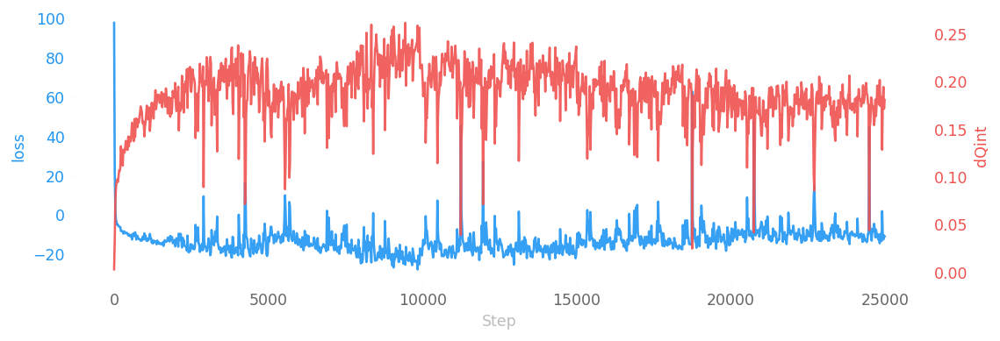

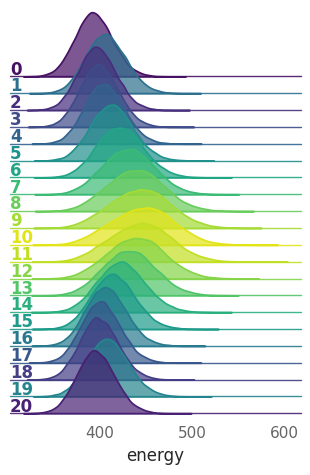

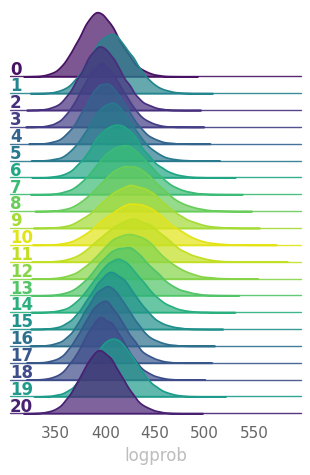

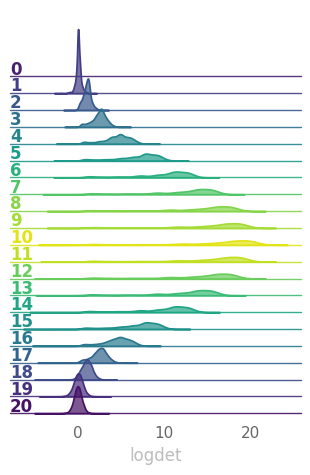

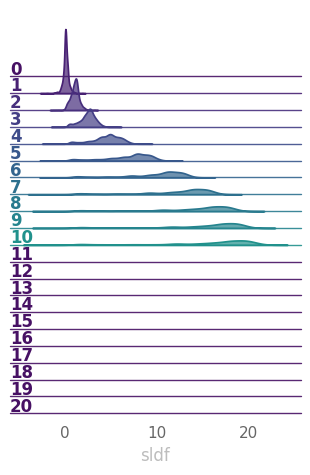

...

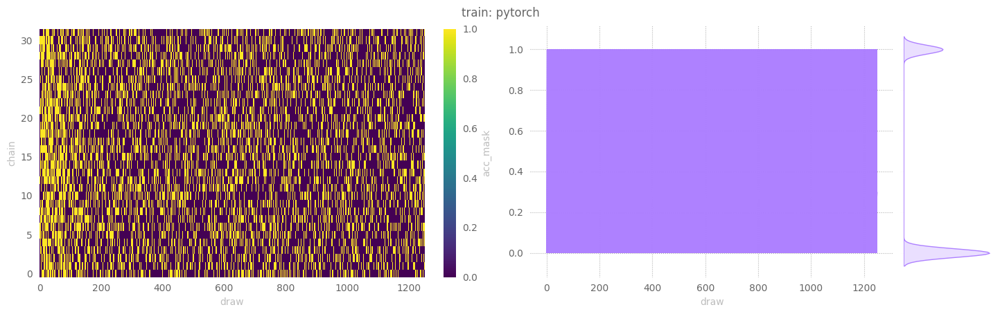

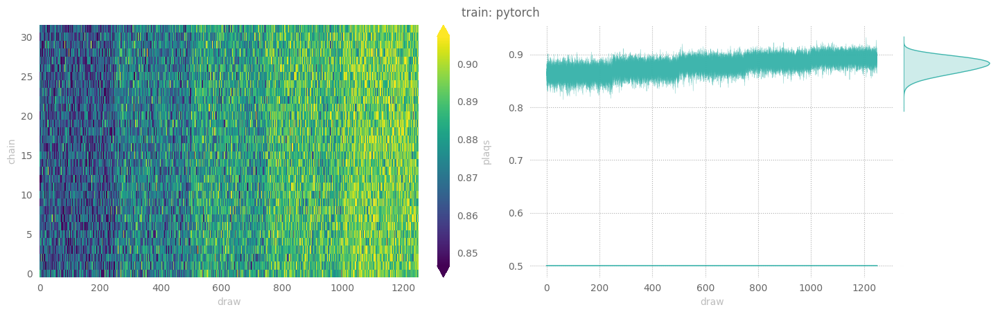

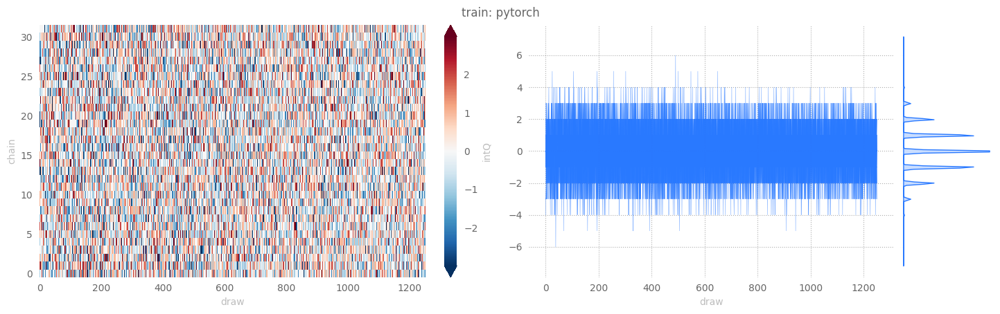

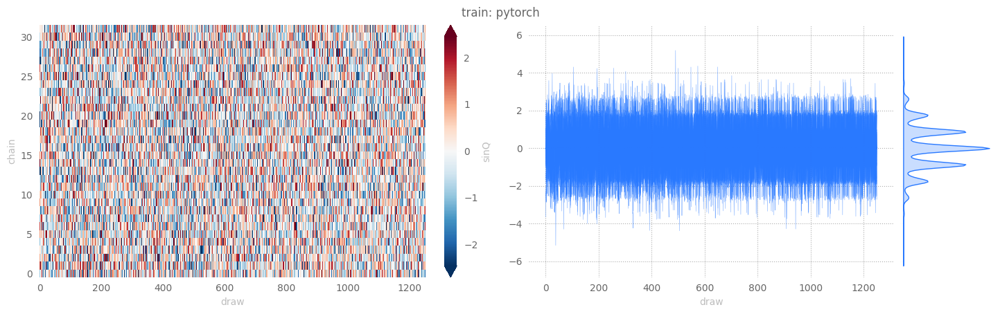

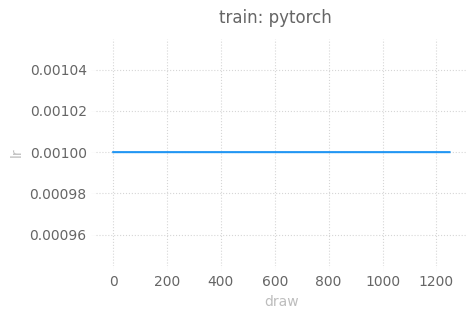

In [7]:
outputs['pytorch']['train'] = ptExpU1.trainer.train()
_ = ptExpU1.save_dataset(job_type='train', nchains=32)

### Inference

#### Evaluation

[12:02:31] WARNING  x.shape (original): torch.Size([4096, 2, 16, 16])

           WARNING  x[:nchains].shape: torch.Size([128, 2, 16, 16])

           INFO     eps=None                                                                 
                    beta=5.0                                                                 
                    nlog=10                                                                  
                    table=<rich.table.Table object at 0x7ff2d41f5f10>                        
                    nprint=500                                                               
                    eval_steps=2000                                                          
                    nleapfrog=None

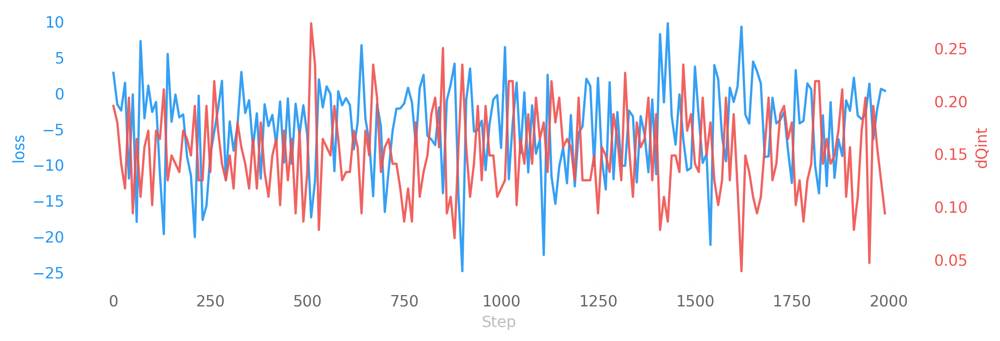

eval:   0%|          | 0/2000 [00:00<?, ?it/s]

[12:02:35] INFO     estep=0   dt=0.1623 beta=5.0000 loss=2.8345 dQsin=0.1910 dQint=0.1953    
                    energy=430.7929 logprob=421.4230 logdet=9.3700 sldf=5.1904 sldb=-5.8398  
                    sldfb=9.3700 sld=9.3700 xeps=0.2155 veps=0.1150 acc=0.2131               
                    sumlogdet=-0.0081 acc_mask=0.2734 plaqs=0.8913 intQ=0.0078 sinQ=0.0013

[13:02:49] INFO     estep=500 dt=0.1107 beta=5.0000 loss=-5.8906 dQsin=0.1533 dQint=0.1328   
                    energy=429.8427 logprob=420.4611 logdet=9.3816 sldf=5.1919 sldb=-5.8325  
                    sldfb=9.3816 sld=9.3816 xeps=0.2155 veps=0.1150 acc=0.2905               
                    sumlogdet=0.0035 acc_mask=0.2969 plaqs=0.8927 intQ=-0.0156 sinQ=-0.0023

[13:02:02] INFO     estep=1000 dt=0.1111 beta=5.0000 loss=-7.6607 dQsin=0.1445 dQint=0.1172  
                    energy=428.7921 logprob=419.3692 logdet=9.4229 sldf=5.2157 sldb=-5.8407  
                    sldfb=9.4229 sld=9.4229 xeps=0.2155 veps=0.1150 acc=0.3318               
                    sumlogdet=0.0183 acc_mask=0.3281 plaqs=0.8927 intQ=0.0156 sinQ=0.0124

[13:02:17] INFO     estep=1500 dt=0.1119 beta=5.0000 loss=3.7007 dQsin=0.1447 dQint=0.1406   
                    energy=429.1244 logprob=419.7544 logdet=9.3700 sldf=5.1904 sldb=-5.8339  
                    sldfb=9.3700 sld=9.3700 xeps=0.2155 veps=0.1150 acc=0.2063               
                    sumlogdet=-0.0039 acc_mask=0.2188 plaqs=0.8936 intQ=-0.0234 sinQ=-0.0249

[13:02:51] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/energy_ridgeplot.svg

[13:02:52] INFO     Ridgeplot for energy took 4.721s

[13:02:56] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/logprob_ridgeplot.svg

[13:02:57] INFO     Ridgeplot for logprob took 4.775s

[13:02:00] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/logdet_ridgeplot.svg

[13:02:01] INFO     Ridgeplot for logdet took 3.932s

[13:02:04] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/sldf_ridgeplot.svg

[13:02:06] INFO     Ridgeplot for sldf took 4.746s

[13:02:10] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/sldb_ridgeplot.svg

[13:02:11] INFO     Ridgeplot for sldb took 5.467s

[13:02:14] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/sldfb_ridgeplot.svg

[13:02:16] INFO     Ridgeplot for sldfb took 4.323s

[13:02:19] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/sld_ridgeplot.svg

[13:02:21] INFO     Ridgeplot for sld took 5.189s

[13:02:39] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/
                    data/eval_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

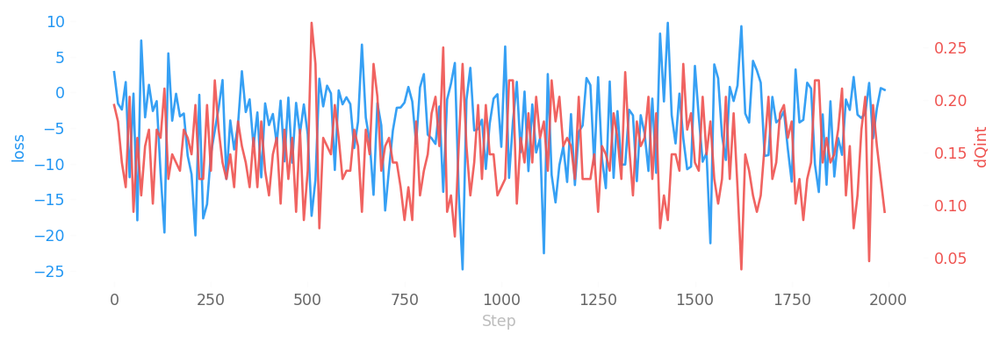

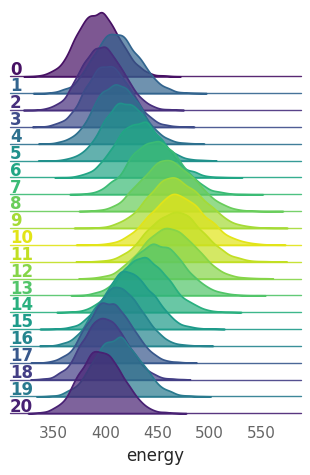

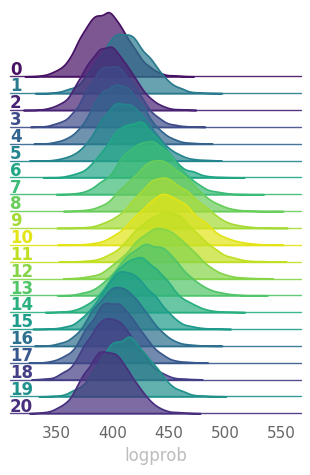

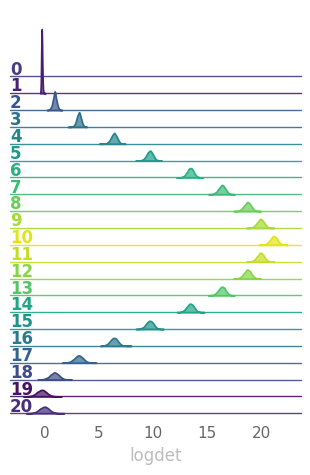

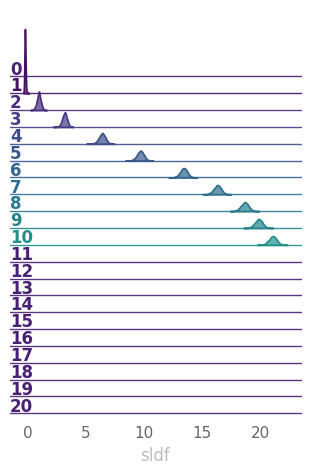

...

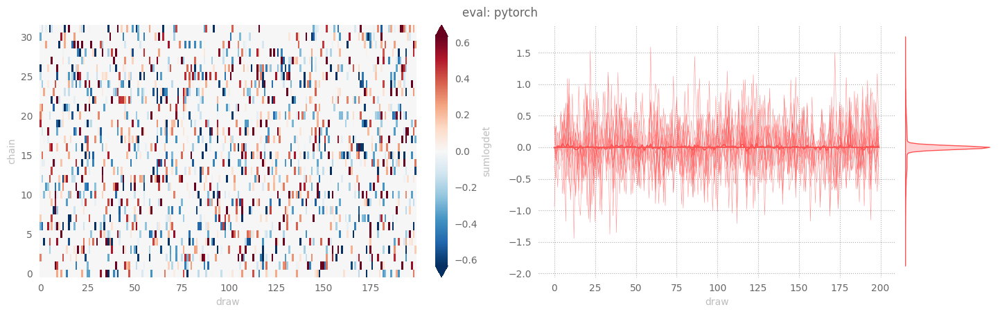

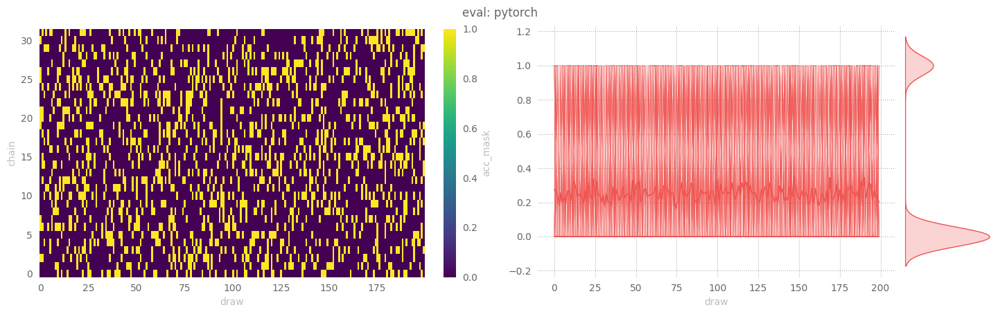

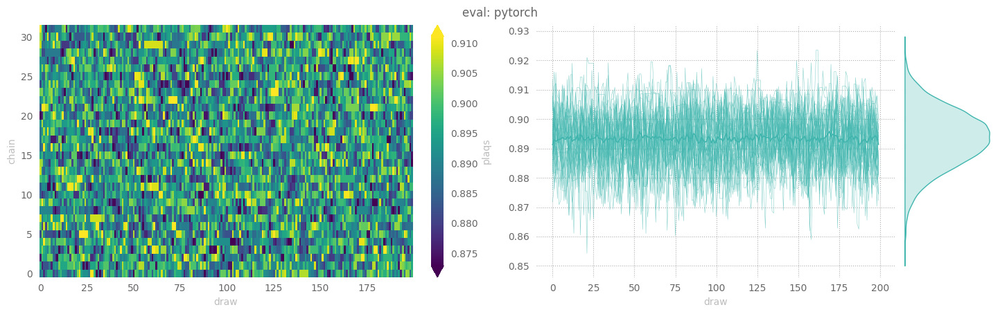

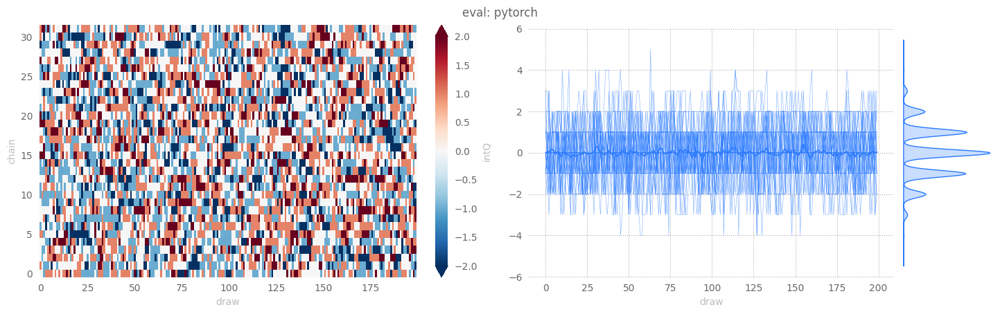

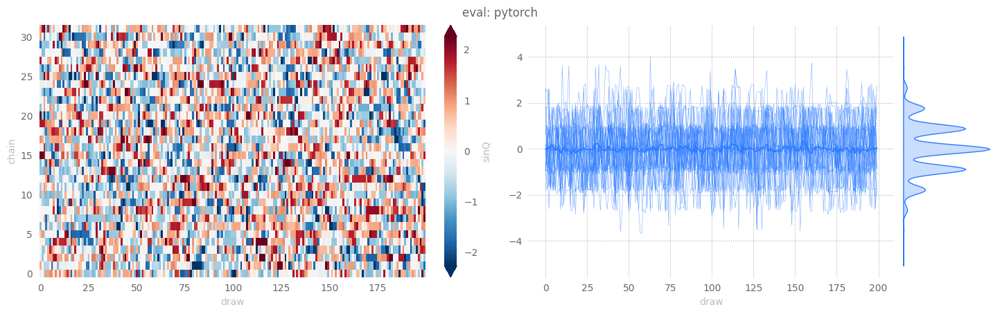

In [8]:
outputs['pytorch']['eval'] = ptExpU1.trainer.eval(
    job_type='eval',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = ptExpU1.save_dataset(job_type='eval', nchains=32)

#### HMC

[13:02:55] WARNING  Step size `eps` not specified for HMC! Using default: 0.1000 for generic 
                    HMC

           WARNING  x.shape (original): torch.Size([4096, 2, 16, 16])

           WARNING  x[:nchains].shape: torch.Size([128, 2, 16, 16])

           INFO     eps=0.1                                                                  
                    beta=5.0                                                                 
                    nlog=10                                                                  
                    table=<rich.table.Table object at 0x7ff2d41f54c0>                        
                    nprint=500                                                               
                    eval_steps=2000                                                          
                    nleapfrog=20

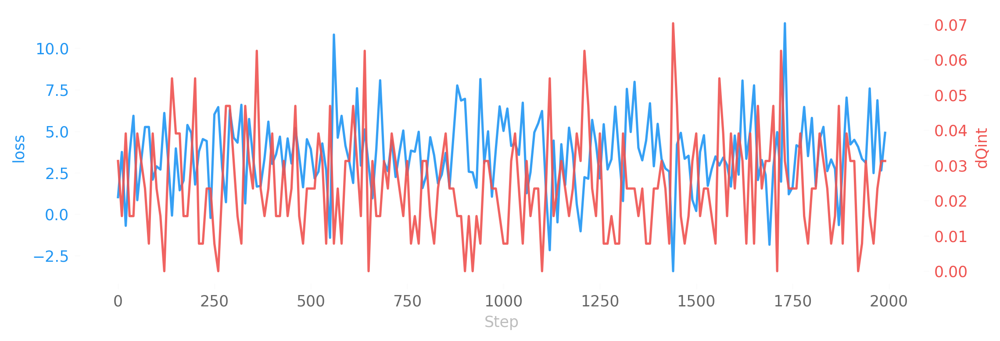

hmc:   0%|          | 0/2000 [00:00<?, ?it/s]

[13:02:00] INFO     hstep=0   dt=0.0488 beta=5.0000 loss=1.0260 dQsin=0.1410 dQint=0.0313    
                    energy=393.9836 logprob=393.9836 logdet=0.0000 acc=0.7689                
                    sumlogdet=0.0000 acc_mask=0.7812 plaqs=0.8921 intQ=0.3125 sinQ=0.2731

[13:02:53] INFO     hstep=500 dt=0.0569 beta=5.0000 loss=3.9278 dQsin=0.1165 dQint=0.0234    
                    energy=395.5971 logprob=395.5971 logdet=0.0000 acc=0.7723                
                    sumlogdet=0.0000 acc_mask=0.7344 plaqs=0.8919 intQ=-0.1563 sinQ=-0.1188

[13:02:48] INFO     hstep=1000 dt=0.0564 beta=5.0000 loss=5.0190 dQsin=0.1153 dQint=0.0078   
                    energy=389.5373 logprob=389.5373 logdet=0.0000 acc=0.7236                
                    sumlogdet=0.0000 acc_mask=0.7188 plaqs=0.8944 intQ=-0.0156 sinQ=0.0003

[13:02:39] INFO     hstep=1500 dt=0.0476 beta=5.0000 loss=0.1911 dQsin=0.1388 dQint=0.0391   
                    energy=392.0126 logprob=392.0126 logdet=0.0000 acc=0.7833                
                    sumlogdet=0.0000 acc_mask=0.7500 plaqs=0.8924 intQ=-0.0078 sinQ=-0.0048

[13:02:34] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/energy_ridgeplot.svg

[13:02:35] INFO     Ridgeplot for energy took 4.876s

[13:02:38] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/logprob_ridgeplot.svg

[13:02:40] INFO     Ridgeplot for logprob took 5.226s

[13:02:43] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/p
                    lots/ridgeplots/svgs/logdet_ridgeplot.svg

[13:02:45] INFO     Ridgeplot for logdet took 4.464s

[13:02:58] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100723/pytorch/
                    data/hmc_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

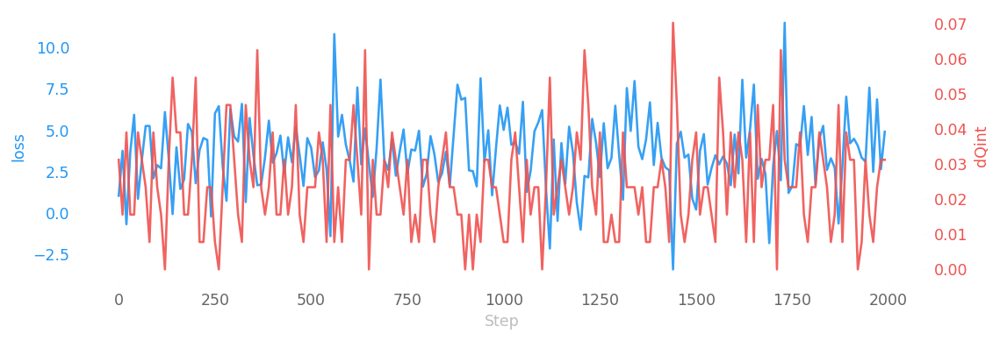

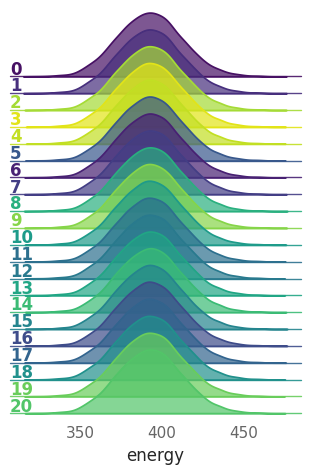

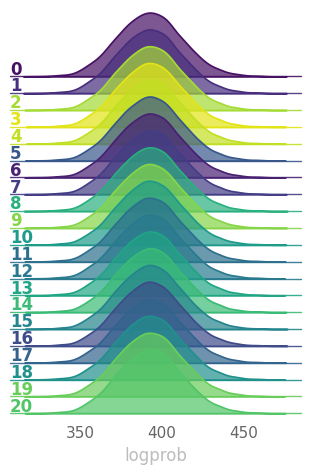

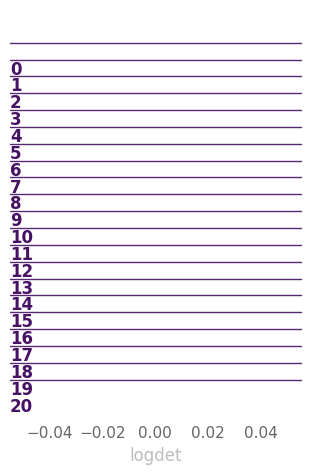

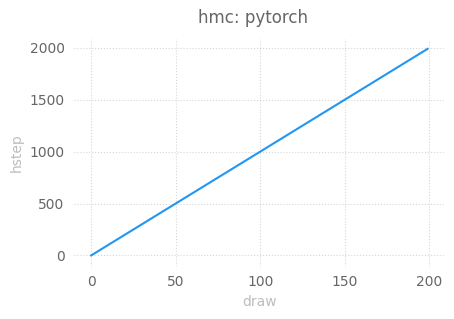

...

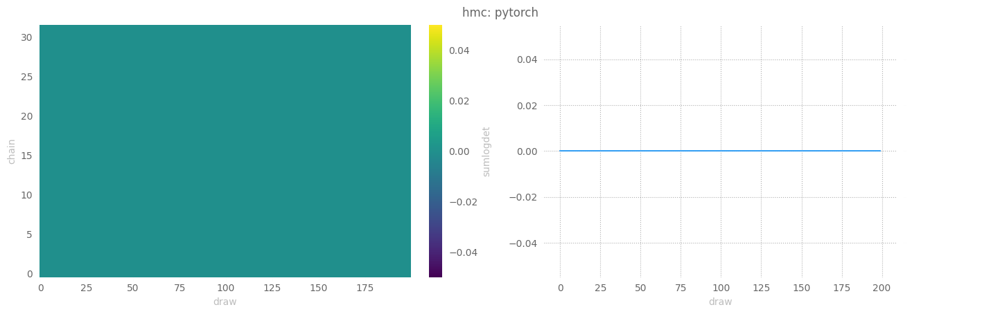

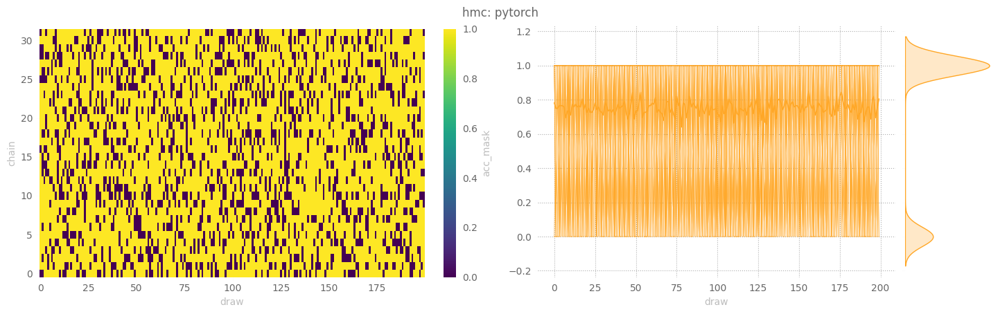

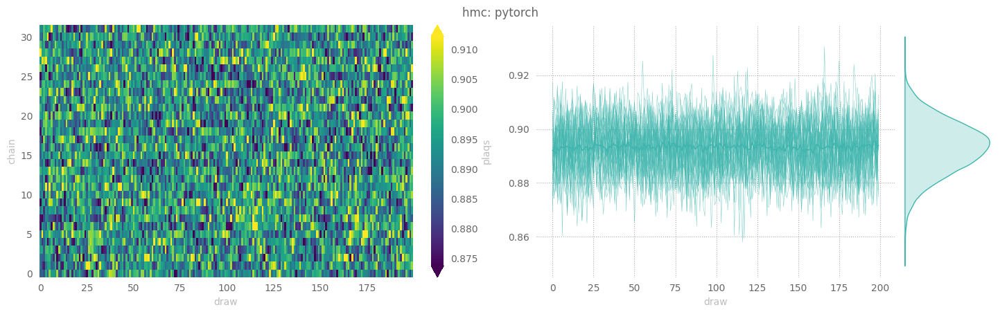

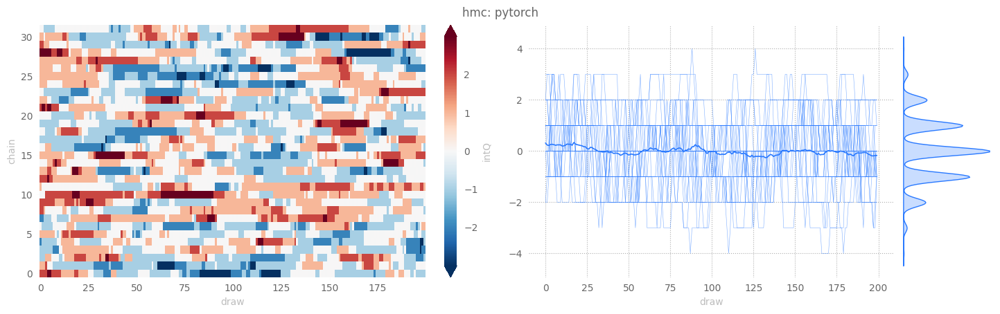

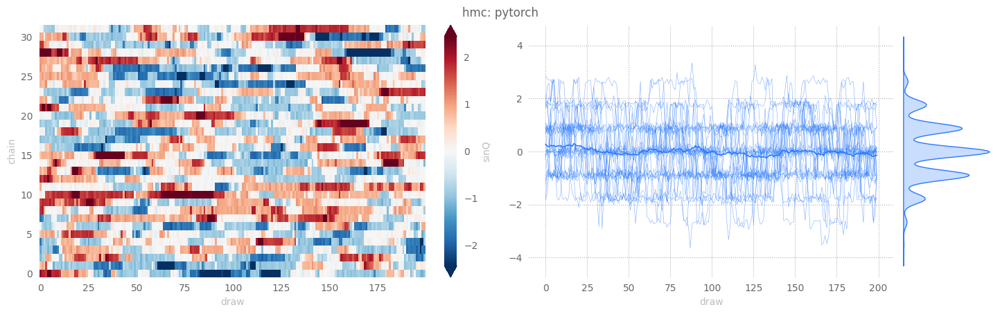

In [9]:
outputs['pytorch']['hmc'] = ptExpU1.trainer.eval(
    job_type='hmc',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = ptExpU1.save_dataset(job_type='hmc', nchains=32)

## TensorFlow

### Train

[13:02:12] INFO     Looking for checkpoints in: /lus/grand/projects/DLHMC/foremans/locations/
                    thetaGPU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xspli
                    t-True/sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/tensorflow

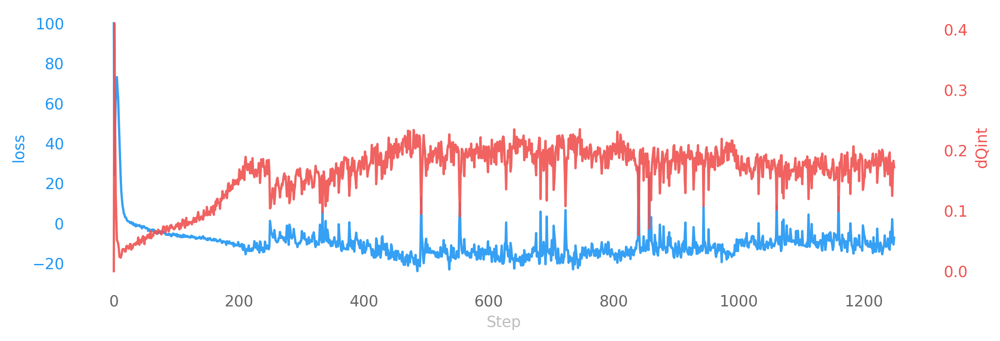

────────────────────────────────── ERA: 0 / 5, BETA: 4.000 ──────────────────────────────────

[13:02:33] INFO     Thermalizing configs @ 4.00 took 79.9778 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

[13:02:20] WARNING  Resetting optimizer state!

           WARNING  Chains are stuck! Re-drawing x !

[13:02:21] INFO     era=0   epoch=0   tstep=1.0000 dt=107.3085 beta=4.0000 loss=99.9868      
                    dQsin=0.0000 dQint=0.0000 energy=1332.8022 logprob=1332.0593             
                    logdet=0.7428 sldf=0.8150 sldb=-0.9588 sldfb=0.7428 sld=0.7428           
                    xeps=0.1000 veps=0.0998 acc=0.0000 sumlogdet=0.0000 acc_mask=0.0000      
                    plaqs=0.0015 intQ=0.0757 sinQ=0.0240 lr=0.0010

[13:02:40] INFO     era=0   epoch=1000 tstep=1001.0000 dt=0.3181 beta=4.0000 loss=-2.2934    
                    dQsin=0.1705 dQint=0.0559 energy=395.0668 logprob=395.7212 logdet=-0.6544
                    sldf=-0.3430 sldb=0.0009 sldfb=-0.6544 sld=-0.6544 xeps=0.0401           
                    veps=0.0380 acc=0.6404 sumlogdet=-0.0044 acc_mask=0.6345 plaqs=0.8635    
                    intQ=-0.0188 sinQ=-0.0162 lr=0.0010

[13:02:23] INFO     era=0   epoch=2000 tstep=2001.0000 dt=0.3058 beta=4.0000 loss=-6.2760    
                    dQsin=0.2236 dQint=0.0771 energy=395.1585 logprob=396.3222 logdet=-1.1638
                    sldf=-0.6270 sldb=0.3494 sldfb=-1.1638 sld=-1.1638 xeps=0.0434           
                    veps=0.0419 acc=0.8036 sumlogdet=0.0074 acc_mask=0.8020 plaqs=0.8635     
                    intQ=-0.0144 sinQ=-0.0171 lr=0.0010

[13:02:09] INFO     era=0   epoch=3000 tstep=3001.0000 dt=0.3496 beta=4.0000 loss=-7.6608    
                    dQsin=0.2323 dQint=0.0923 energy=395.6386 logprob=396.3184 logdet=-0.6798
                    sldf=-0.3647 sldb=0.1762 sldfb=-0.6798 sld=-0.6798 xeps=0.0554           
                    veps=0.0525 acc=0.8095 sumlogdet=-0.0009 acc_mask=0.8088 plaqs=0.8634    
                    intQ=0.0022 sinQ=0.0025 lr=0.0010

[13:02:50] INFO     era=0   epoch=4000 tstep=4001.0000 dt=0.3168 beta=4.0000 loss=-10.7294   
                    dQsin=0.2104 dQint=0.1489 energy=398.7417 logprob=398.2735 logdet=0.4682 
                    sldf=0.2636 sldb=-0.3502 sldfb=0.4682 sld=0.4682 xeps=0.1036 veps=0.0871 
                    acc=0.5340 sumlogdet=-0.0029 acc_mask=0.5381 plaqs=0.8632 intQ=-0.0051   
                    sinQ=-0.0012 lr=0.0010

[13:02:30] INFO     Saving took: 0.878704s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/tensorflow

           INFO     Era 0 took: 1937.4s

────────────────────────────────── ERA: 1 / 5, BETA: 4.250 ──────────────────────────────────

           INFO     Thermalizing configs @ 4.25 took 59.5522 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

[13:02:31] INFO     era=1   epoch=0   tstep=5001.0000 dt=0.3497 beta=4.2500 loss=1.1596      
                    dQsin=0.1288 dQint=0.1038 energy=401.3426 logprob=399.5392 logdet=1.8034 
                    sldf=1.0073 sldb=-1.2673 sldfb=1.8034 sld=1.8034 xeps=0.1398 veps=0.1081 
                    acc=0.3065 sumlogdet=0.0010 acc_mask=0.3047 plaqs=0.8726 intQ=-0.0076    
                    sinQ=-0.0061 lr=0.0010

[13:02:11] INFO     era=1   epoch=1000 tstep=6001.0000 dt=0.3166 beta=4.2500 loss=-8.8604    
                    dQsin=0.1788 dQint=0.1523 energy=403.4713 logprob=400.5101 logdet=2.9612 
                    sldf=1.6459 sldb=-1.9694 sldfb=2.9612 sld=2.9612 xeps=0.1563 veps=0.1203 
                    acc=0.3868 sumlogdet=0.0004 acc_mask=0.3877 plaqs=0.8726 intQ=0.0139     
                    sinQ=0.0114 lr=0.0010

[13:02:50] INFO     era=1   epoch=2000 tstep=7001.0000 dt=0.3138 beta=4.2500 loss=-11.2836   
                    dQsin=0.1946 dQint=0.1697 energy=405.4368 logprob=401.3654 logdet=4.0714 
                    sldf=2.2482 sldb=-2.4138 sldfb=4.0714 sld=4.0714 xeps=0.1616 veps=0.1261 
                    acc=0.4070 sumlogdet=-0.0003 acc_mask=0.4102 plaqs=0.8725 intQ=0.0173    
                    sinQ=0.0129 lr=0.0010

[14:02:32] INFO     era=1   epoch=3000 tstep=8001.0000 dt=0.3482 beta=4.2500 loss=-9.3666    
                    dQsin=0.1776 dQint=0.1685 energy=408.5833 logprob=403.2744 logdet=5.3089 
                    sldf=2.9107 sldb=-2.7117 sldfb=5.3089 sld=5.3089 xeps=0.1739 veps=0.1276 
                    acc=0.3318 sumlogdet=-0.0007 acc_mask=0.3267 plaqs=0.8722 intQ=-0.0107   
                    sinQ=-0.0087 lr=0.0010

[14:02:17] INFO     era=1   epoch=4000 tstep=9001.0000 dt=0.3200 beta=4.2500 loss=-15.4231   
                    dQsin=0.1945 dQint=0.1973 energy=412.1772 logprob=407.2142 logdet=4.9629 
                    sldf=2.7380 sldb=-2.8709 sldfb=4.9629 sld=4.9629 xeps=0.1877 veps=0.1226 
                    acc=0.2943 sumlogdet=0.0022 acc_mask=0.2905 plaqs=0.8725 intQ=0.0193     
                    sinQ=0.0158 lr=0.0010

[14:02:57] INFO     Saving took: 0.500349s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/tensorflow

           INFO     Era 1 took: 1766.79s

           INFO     Avgs over last era:                                                      
                     tstep=7491.0000, dt=0.3261, beta=4.2500, loss=-10.8969, dQsin=0.1855,   
                    dQint=0.1688, energy=407.4918, logprob=403.5222, logdet=3.9695,          
                    sldf=2.1950, sldb=-2.3892, sldfb=3.9695, sld=3.9695, xeps=0.1696,        
                    veps=0.1220, acc=0.3494, sumlogdet=0.0001, acc_mask=0.3495, plaqs=0.8724,
                    intQ=-0.0026, sinQ=-0.0020, lr=0.0010                                    
           

────────────────────────────────── ERA: 2 / 5, BETA: 4.500 ──────────────────────────────────

           INFO     Thermalizing configs @ 4.50 took 59.5987 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

           INFO     era=2   epoch=0   tstep=10001.0000 dt=0.3521 beta=4.5000 loss=-7.7971    
                    dQsin=0.1629 dQint=0.1575 energy=414.5557 logprob=409.3765 logdet=5.1792 
                    sldf=2.8556 sldb=-2.9263 sldfb=5.1792 sld=5.1792 xeps=0.1931 veps=0.1194 
                    acc=0.2775 sumlogdet=-0.0065 acc_mask=0.2759 plaqs=0.8806 intQ=0.0090    
                    sinQ=0.0080 lr=0.0010

[14:02:42] INFO     era=2   epoch=1000 tstep=11001.0000 dt=0.3216 beta=4.5000 loss=-15.6435  
                    dQsin=0.2052 dQint=0.2056 energy=416.8161 logprob=411.5283 logdet=5.2878 
                    sldf=2.9139 sldb=-2.9704 sldfb=5.2878 sld=5.2878 xeps=0.1962 veps=0.1178 
                    acc=0.3132 sumlogdet=0.0025 acc_mask=0.3193 plaqs=0.8803 intQ=0.0056     
                    sinQ=0.0036 lr=0.0010

[14:02:24] INFO     era=2   epoch=2000 tstep=12001.0000 dt=0.3161 beta=4.5000 loss=-15.6363  
                    dQsin=0.2018 dQint=0.2061 energy=416.7296 logprob=411.6899 logdet=5.0397 
                    sldf=2.7816 sldb=-2.9926 sldfb=5.0397 sld=5.0397 xeps=0.1994 veps=0.1169 
                    acc=0.2885 sumlogdet=0.0016 acc_mask=0.2910 plaqs=0.8804 intQ=-0.0222    
                    sinQ=-0.0173 lr=0.0010

[14:02:08] INFO     era=2   epoch=3000 tstep=13001.0000 dt=0.3681 beta=4.5000 loss=-16.8413  
                    dQsin=0.1980 dQint=0.2058 energy=421.5036 logprob=416.2450 logdet=5.2586 
                    sldf=2.8985 sldb=-2.9792 sldfb=5.2586 sld=5.2586 xeps=0.2092 veps=0.1128 
                    acc=0.2491 sumlogdet=0.0023 acc_mask=0.2502 plaqs=0.8803 intQ=-0.0032    
                    sinQ=-0.0002 lr=0.0010

[14:02:49] INFO     era=2   epoch=4000 tstep=14001.0000 dt=0.3264 beta=4.5000 loss=-18.7667  
                    dQsin=0.1976 dQint=0.2041 energy=420.7215 logprob=415.0620 logdet=5.6596 
                    sldf=3.1133 sldb=-3.0513 sldfb=5.6596 sld=5.6596 xeps=0.2053 veps=0.1144 
                    acc=0.2728 sumlogdet=0.0004 acc_mask=0.2688 plaqs=0.8802 intQ=-0.0439    
                    sinQ=-0.0372 lr=0.0010

[14:02:28] INFO     Saving took: 0.485389s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/tensorflow

           INFO     Era 2 took: 1770.84s

           INFO     Avgs over last era:                                                      
                     tstep=12491.0000, dt=0.3235, beta=4.5000, loss=-14.9505, dQsin=0.1926,  
                    dQint=0.1946, energy=418.7132, logprob=413.3235, logdet=5.3897,          
                    sldf=2.9671, sldb=-2.9836, sldfb=5.3897, sld=5.3897, xeps=0.2018,        
                    veps=0.1159, acc=0.2771, sumlogdet=-0.0004, acc_mask=0.2776,             
                    plaqs=0.8803, intQ=-0.0017, sinQ=-0.0018, lr=0.0010                      
           

────────────────────────────────── ERA: 3 / 5, BETA: 4.750 ──────────────────────────────────

[14:02:27] INFO     Thermalizing configs @ 4.75 took 59.2298 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

[14:02:28] INFO     era=3   epoch=0   tstep=15001.0000 dt=0.3301 beta=4.7500 loss=-12.1686   
                    dQsin=0.1786 dQint=0.1819 energy=423.0204 logprob=417.6905 logdet=5.3299 
                    sldf=2.9342 sldb=-2.9468 sldfb=5.3299 sld=5.3299 xeps=0.2103 veps=0.1118 
                    acc=0.2685 sumlogdet=0.0028 acc_mask=0.2605 plaqs=0.8872 intQ=-0.0056    
                    sinQ=-0.0047 lr=0.0010

[14:02:03] INFO     era=3   epoch=1000 tstep=16001.0000 dt=0.3174 beta=4.7500 loss=-16.0832  
                    dQsin=0.2031 dQint=0.2063 energy=423.7605 logprob=418.5074 logdet=5.2532 
                    sldf=2.8909 sldb=-2.9142 sldfb=5.2532 sld=5.2532 xeps=0.2121 veps=0.1106 
                    acc=0.2922 sumlogdet=0.0024 acc_mask=0.2964 plaqs=0.8871 intQ=-0.0261    
                    sinQ=-0.0258 lr=0.0010

[14:02:40] INFO     era=3   epoch=2000 tstep=17001.0000 dt=0.3111 beta=4.7500 loss=-12.7476  
                    dQsin=0.1818 dQint=0.1843 energy=423.2046 logprob=418.1571 logdet=5.0476 
                    sldf=2.7834 sldb=-2.8684 sldfb=5.0476 sld=5.0476 xeps=0.2109 veps=0.1118 
                    acc=0.2792 sumlogdet=0.0008 acc_mask=0.2795 plaqs=0.8871 intQ=-0.0176    
                    sinQ=-0.0170 lr=0.0010

[14:02:16] INFO     era=3   epoch=3000 tstep=18001.0000 dt=0.3116 beta=4.7500 loss=-12.6400  
                    dQsin=0.1910 dQint=0.1973 energy=426.8237 logprob=421.5736 logdet=5.2502 
                    sldf=2.8912 sldb=-2.9306 sldfb=5.2502 sld=5.2502 xeps=0.2153 veps=0.1068 
                    acc=0.2406 sumlogdet=0.0053 acc_mask=0.2434 plaqs=0.8873 intQ=0.0012     
                    sinQ=0.0018 lr=0.0010

[15:02:57] INFO     era=3   epoch=4000 tstep=19001.0000 dt=0.3090 beta=4.7500 loss=-12.6134  
                    dQsin=0.1850 dQint=0.1863 energy=422.5031 logprob=417.0401 logdet=5.4630 
                    sldf=3.0090 sldb=-3.0821 sldfb=5.4630 sld=5.4630 xeps=0.2107 veps=0.1136 
                    acc=0.2765 sumlogdet=-0.0033 acc_mask=0.2786 plaqs=0.8875 intQ=0.0239    
                    sinQ=0.0214 lr=0.0010

[15:02:35] INFO     Saving took: 0.779905s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/tensorflow

           INFO     Era 3 took: 1747.11s

           INFO     Avgs over last era:                                                      
                     tstep=17491.0000, dt=0.3169, beta=4.7500, loss=-12.6153, dQsin=0.1847,  
                    dQint=0.1860, energy=422.7833, logprob=417.4471, logdet=5.3363,          
                    sldf=2.9387, sldb=-2.9849, sldfb=5.3363, sld=5.3363, xeps=0.2112,        
                    veps=0.1126, acc=0.2758, sumlogdet=-0.0001, acc_mask=0.2756,             
                    plaqs=0.8872, intQ=-0.0019, sinQ=-0.0018, lr=0.0010                      
           

────────────────────────────────── ERA: 4 / 5, BETA: 5.000 ──────────────────────────────────

[15:02:36] INFO     Thermalizing configs @ 5.00 took 60.8817 s

Training:   0%|          | 0/5000 [00:00<?, ?it/s]

[15:02:37] INFO     era=4   epoch=0   tstep=20001.0000 dt=0.3444 beta=5.0000 loss=-8.3784    
                    dQsin=0.1727 dQint=0.1687 energy=423.5200 logprob=418.0054 logdet=5.5145 
                    sldf=3.0354 sldb=-3.0494 sldfb=5.5145 sld=5.5145 xeps=0.2140 veps=0.1131 
                    acc=0.2874 sumlogdet=-0.0025 acc_mask=0.2947 plaqs=0.8934 intQ=0.0117    
                    sinQ=0.0104 lr=0.0010

           INFO     era=4   epoch=1000 tstep=21001.0000 dt=0.6753 beta=5.0000 loss=-10.7365  
                    dQsin=0.1720 dQint=0.1687 energy=426.3723 logprob=420.4616 logdet=5.9108 
                    sldf=3.2462 sldb=-3.1321 sldfb=5.9108 sld=5.9108 xeps=0.2176 veps=0.1104 
                    acc=0.2815 sumlogdet=-0.0020 acc_mask=0.2822 plaqs=0.8932 intQ=-0.0117   
                    sinQ=-0.0116 lr=0.0010

[15:02:27] INFO     era=4   epoch=2000 tstep=22001.0000 dt=0.3442 beta=5.0000 loss=-9.3184   
                    dQsin=0.1710 dQint=0.1680 energy=425.4965 logprob=420.0269 logdet=5.4696 
                    sldf=3.0137 sldb=-3.1116 sldfb=5.4696 sld=5.4696 xeps=0.2145 veps=0.1092 
                    acc=0.2733 sumlogdet=0.0015 acc_mask=0.2722 plaqs=0.8933 intQ=-0.0144    
                    sinQ=-0.0133 lr=0.0010

[15:02:18] INFO     era=4   epoch=3000 tstep=23001.0000 dt=0.3165 beta=5.0000 loss=-11.0928  
                    dQsin=0.1733 dQint=0.1714 energy=425.2702 logprob=418.9334 logdet=6.3368 
                    sldf=3.4734 sldb=-3.2303 sldfb=6.3368 sld=6.3368 xeps=0.2161 veps=0.1137 
                    acc=0.2916 sumlogdet=-0.0003 acc_mask=0.2874 plaqs=0.8934 intQ=0.0098    
                    sinQ=0.0096 lr=0.0010

[15:02:08] INFO     era=4   epoch=4000 tstep=24001.0000 dt=0.3123 beta=5.0000 loss=-3.3165   
                    dQsin=0.1441 dQint=0.1409 energy=425.1684 logprob=419.3830 logdet=5.7854 
                    sldf=3.1838 sldb=-3.2121 sldfb=5.7854 sld=5.7854 xeps=0.2201 veps=0.1139 
                    acc=0.2423 sumlogdet=0.0018 acc_mask=0.2424 plaqs=0.8935 intQ=-0.0173    
                    sinQ=-0.0107 lr=0.0010

[15:02:57] INFO     Saving took: 1.06232s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-10/xsplit-True/
                    sepnets-True/merge-True/net-16-32-64_dp-0.2_bn-False/tensorflow

           INFO     Era 4 took: 1822.2s

[15:02:09] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/energy_ridgeplot.svg

[15:02:10] INFO     Ridgeplot for energy took 11.579s

[15:02:20] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[15:02:22] INFO     Ridgeplot for logprob took 12.060s

[15:02:32] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[15:02:33] INFO     Ridgeplot for logdet took 10.735s

[15:02:41] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[15:02:42] INFO     Ridgeplot for sldf took 8.624s

[15:02:49] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[15:02:50] INFO     Ridgeplot for sldb took 8.501s

[15:02:00] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/sldfb_ridgeplot.svg

[15:02:01] INFO     Ridgeplot for sldfb took 10.822s

[15:02:11] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/sld_ridgeplot.svg

[15:02:12] INFO     Ridgeplot for sld took 11.274s

[15:02:21] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorfl
                    ow/data/train_data.h5

[15:02:20] INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

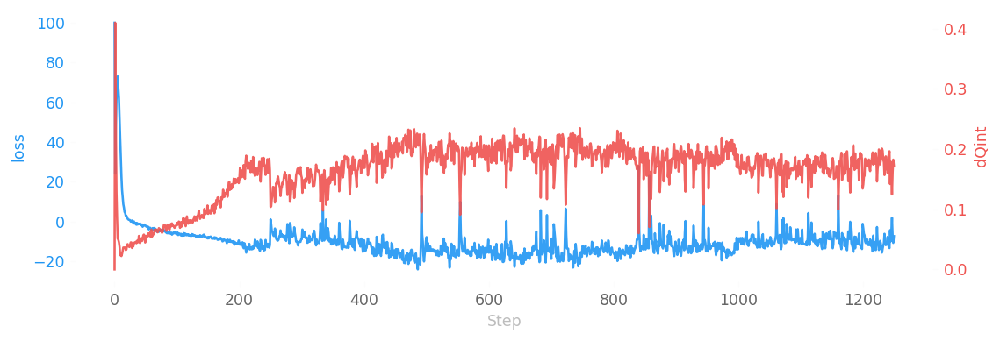

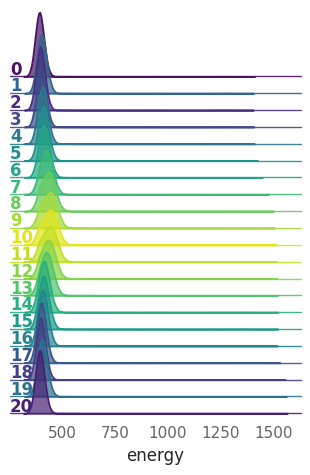

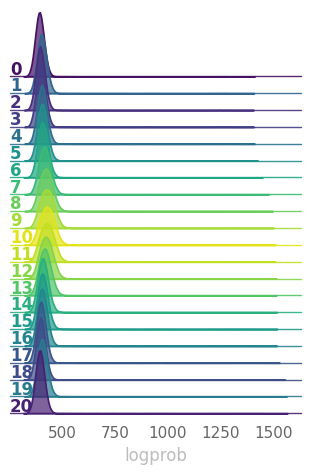

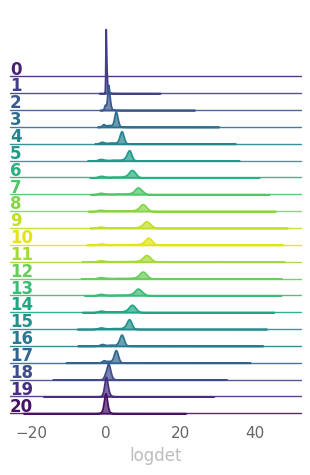

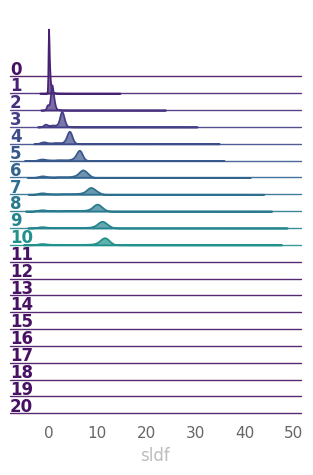

...

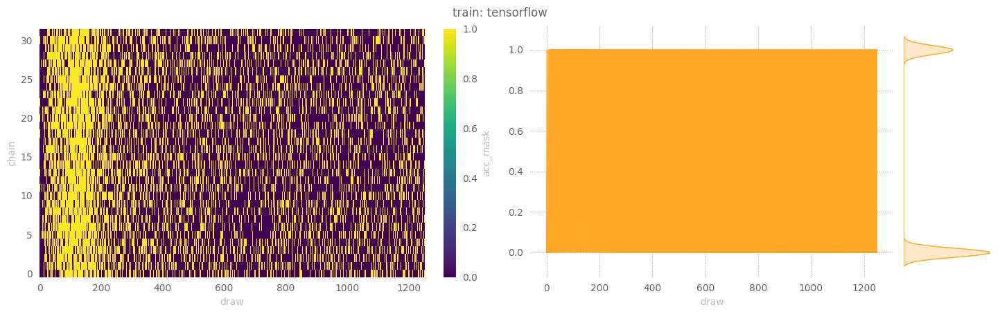

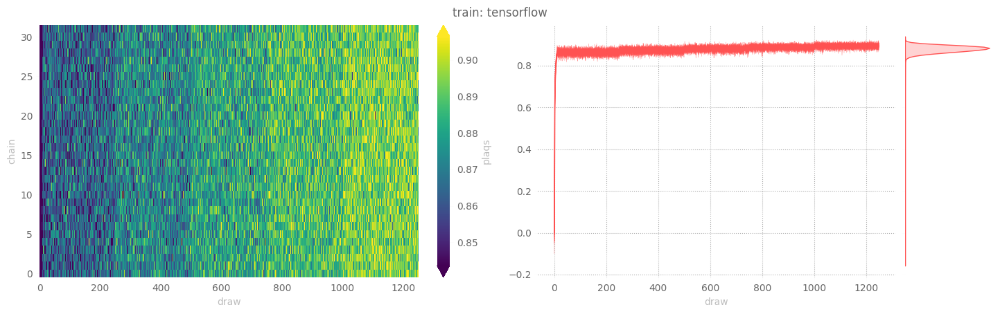

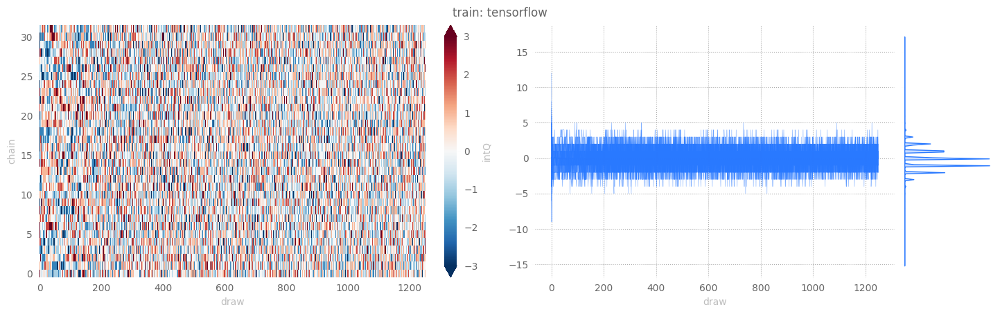

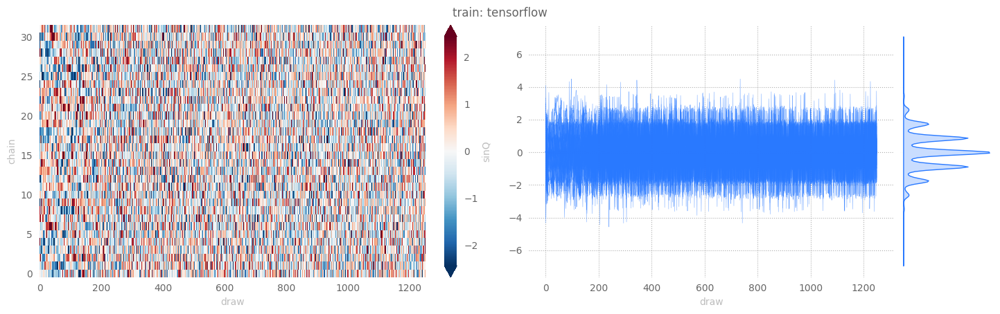

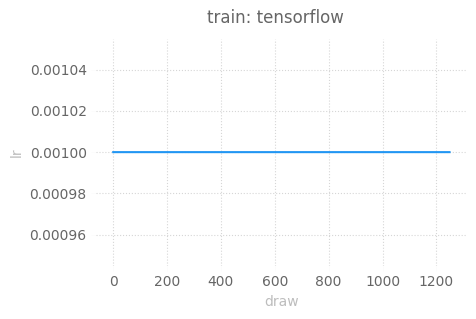

In [10]:
outputs['tensorflow']['train'] = tfExpU1.trainer.train()
_ = tfExpU1.save_dataset(job_type='train', nchains=32)

### Inference

#### Evaluate

[15:02:37] WARNING  x.shape (original): (4096, 2, 16, 16)

           WARNING  x[:nchains].shape: (128, 2, 16, 16)

           INFO     eps = None                                                               
                    beta = 5.0                                                               
                    nlog = 10                                                                
                    table = <rich.table.Table object at 0x7fecc876cfd0>                      
                    nprint = 500                                                             
                    eval_steps = 2000                                                        
                    nleapfrog = None

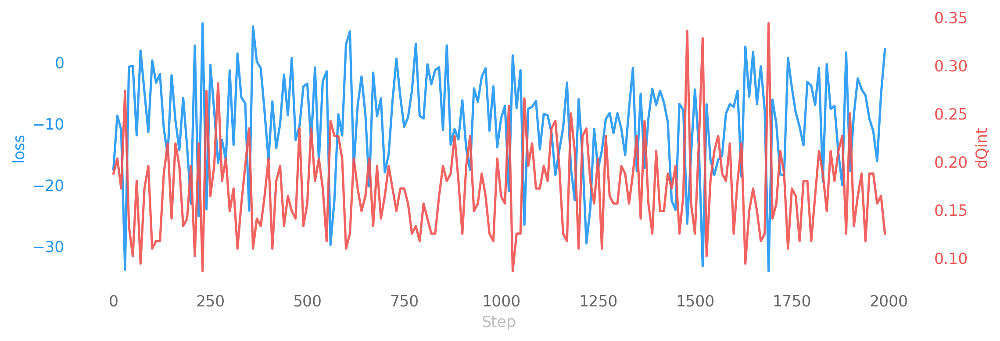

  0%|          | 0/2000 [00:00<?, ?it/s]

[15:02:53] INFO     estep=0   dt=15.1641 beta=5.0000 loss=-17.4976 dQsin=0.2029 dQint=0.1875 
                    energy=428.6869 logprob=422.8735 logdet=5.8133 sldf=3.1948 sldb=-3.2088  
                    sld=5.8133 xeps=0.2237 veps=0.1097 acc=0.2618 sumlogdet=0.0125           
                    acc_mask=0.3047 plaqs=0.8920 intQ=0.0313 sinQ=0.0082

[15:02:50] INFO     estep=500 dt=0.0534 beta=5.0000 loss=-3.5037 dQsin=0.1557 dQint=0.1563   
                    energy=431.0938 logprob=425.2717 logdet=5.8221 sldf=3.1988 sldb=-3.2165  
                    sld=5.8221 xeps=0.2237 veps=0.1097 acc=0.2847 sumlogdet=-0.0002          
                    acc_mask=0.2578 plaqs=0.8925 intQ=0.0859 sinQ=0.0855

[15:02:36] INFO     estep=1000 dt=0.0534 beta=5.0000 loss=-9.1598 dQsin=0.1623 dQint=0.1641  
                    energy=429.5522 logprob=423.7520 logdet=5.8002 sldf=3.1949 sldb=-3.2191  
                    sld=5.8002 xeps=0.2237 veps=0.1097 acc=0.2696 sumlogdet=0.0108           
                    acc_mask=0.2812 plaqs=0.8934 intQ=0.0078 sinQ=0.0190

[15:02:23] INFO     estep=1500 dt=0.0559 beta=5.0000 loss=-4.4708 dQsin=0.1368 dQint=0.1250  
                    energy=427.1269 logprob=421.3251 logdet=5.8017 sldf=3.1934 sldb=-3.2180  
                    sld=5.8017 xeps=0.2237 veps=0.1097 acc=0.2652 sumlogdet=-0.0066          
                    acc_mask=0.2500 plaqs=0.8939 intQ=0.0938 sinQ=0.0730

[15:02:13] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/energy_ridgeplot.svg

[15:02:14] INFO     Ridgeplot for energy took 4.008s

[15:02:17] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[15:02:19] INFO     Ridgeplot for logprob took 4.471s

[15:02:21] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[15:02:23] INFO     Ridgeplot for logdet took 3.928s

[15:02:25] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[15:02:27] INFO     Ridgeplot for sldf took 3.717s

[15:02:29] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[15:02:30] INFO     Ridgeplot for sldb took 3.702s

[15:02:33] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/sld_ridgeplot.svg

[15:02:34] INFO     Ridgeplot for sld took 4.021s

[15:02:50] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorfl
                    ow/data/eval_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

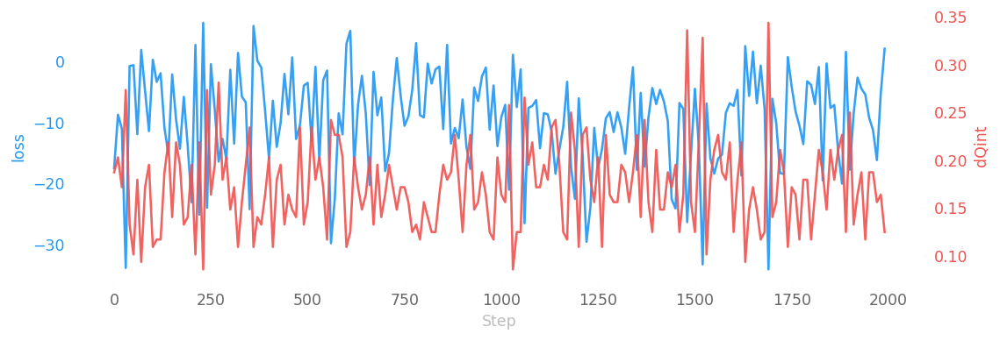

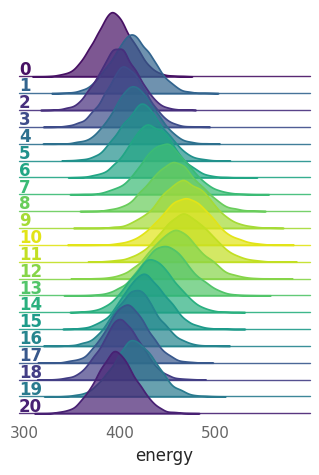

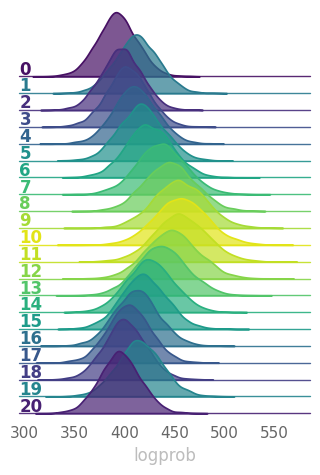

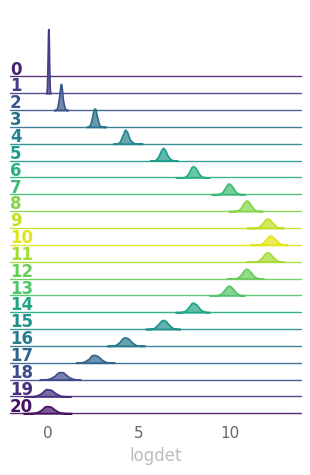

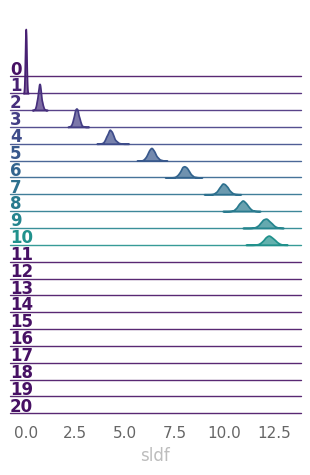

...

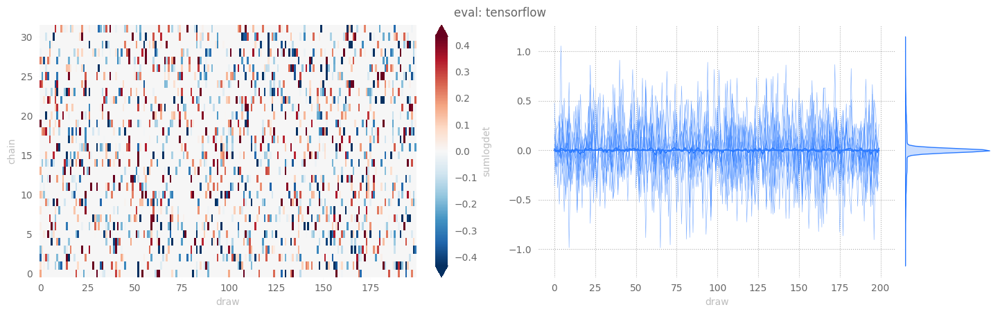

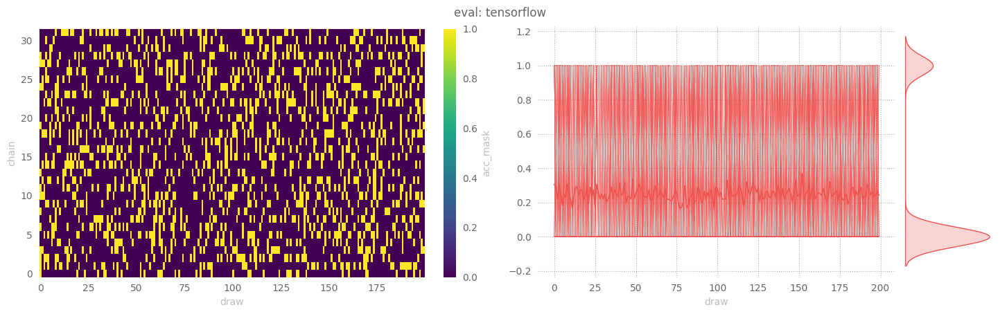

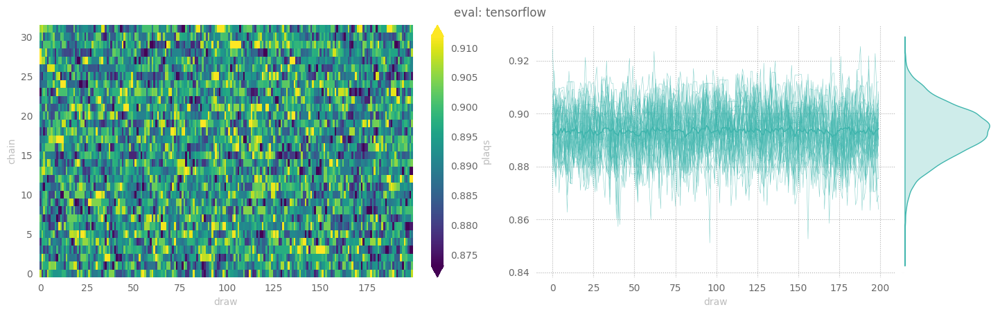

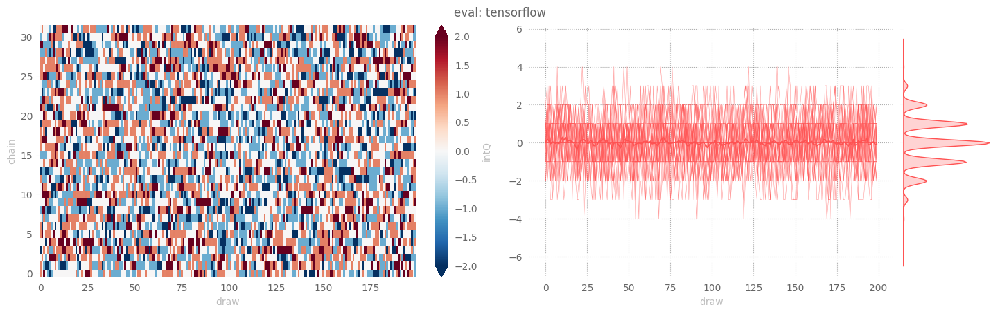

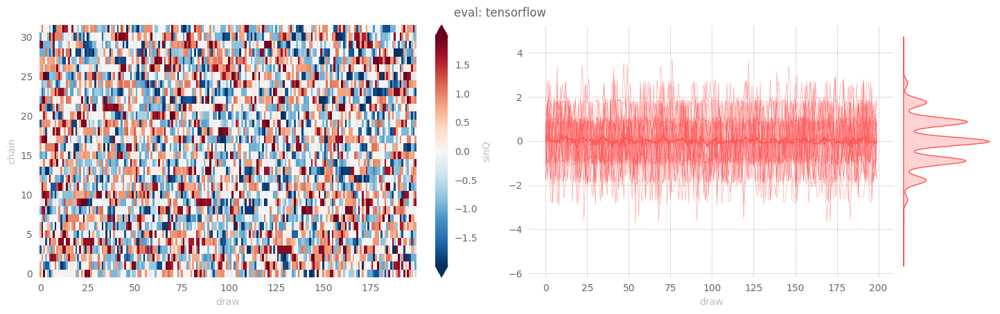

In [11]:
outputs['tensorflow']['eval'] = tfExpU1.trainer.eval(
    job_type='eval',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = tfExpU1.save_dataset(job_type='eval', nchains=32)

#### HMC

[15:02:01] WARNING  Step size `eps` not specified for HMC! Using default: 0.1000 for generic 
                    HMC

           WARNING  x.shape (original): (4096, 2, 16, 16)

           WARNING  x[:nchains].shape: (128, 2, 16, 16)

           INFO     eps = 0.1                                                                
                    beta = 5.0                                                               
                    nlog = 10                                                                
                    table = <rich.table.Table object at 0x7febe40a2fa0>                      
                    nprint = 500                                                             
                    eval_steps = 2000                                                        
                    nleapfrog = 20

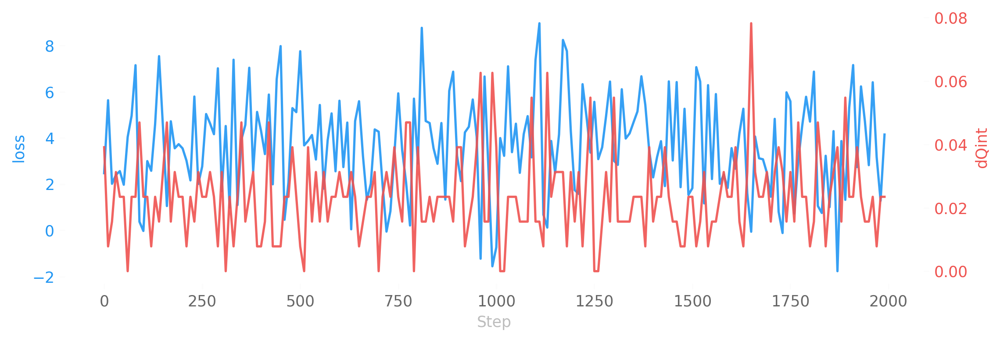

  0%|          | 0/2000 [00:00<?, ?it/s]

           INFO     hstep=0   dt=0.1204 beta=5.0000 loss=2.4774 dQsin=0.1287 dQint=0.0391    
                    energy=395.1422 logprob=395.1422 logdet=0.0000 acc=0.7174                
                    sumlogdet=0.0000 acc_mask=0.7109 plaqs=0.8933 intQ=0.0781 sinQ=0.0650

[15:02:22] INFO     hstep=500 dt=0.1209 beta=5.0000 loss=7.7530 dQsin=0.1113 dQint=0.0078    
                    energy=390.6946 logprob=390.6946 logdet=0.0000 acc=0.7510                
                    sumlogdet=0.0000 acc_mask=0.7578 plaqs=0.8940 intQ=0.0156 sinQ=0.0071

[15:02:42] INFO     hstep=1000 dt=0.1187 beta=5.0000 loss=-0.7337 dQsin=0.1413 dQint=0.0391  
                    energy=391.7993 logprob=391.7993 logdet=0.0000 acc=0.7888                
                    sumlogdet=0.0000 acc_mask=0.7969 plaqs=0.8937 intQ=-0.0547 sinQ=-0.0443

[15:02:05] INFO     hstep=1500 dt=0.1441 beta=5.0000 loss=1.8296 dQsin=0.1456 dQint=0.0234   
                    energy=391.9207 logprob=391.9207 logdet=0.0000 acc=0.7798                
                    sumlogdet=0.0000 acc_mask=0.7891 plaqs=0.8943 intQ=0.1406 sinQ=0.1359

[15:02:31] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/energy_ridgeplot.svg

[15:02:32] INFO     Ridgeplot for energy took 4.859s

[15:02:35] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[15:02:36] INFO     Ridgeplot for logprob took 4.125s

[15:02:38] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorflo
                    w/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[15:02:40] INFO     Ridgeplot for logdet took 3.489s

[15:02:50] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-21-100730/tensorfl
                    ow/data/hmc_data.h5

[15:02:51] INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

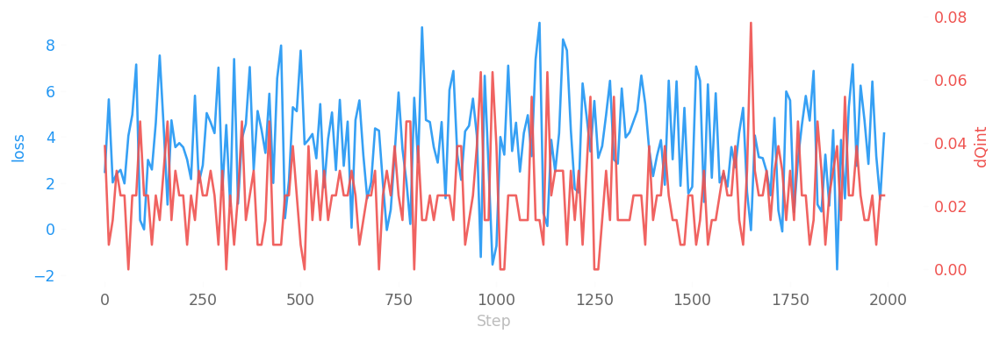

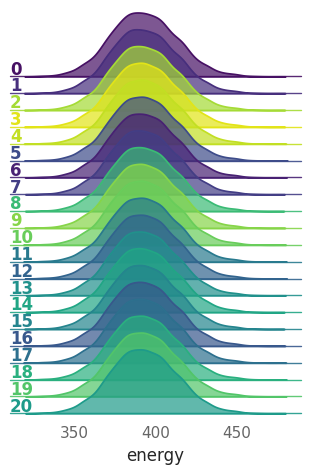

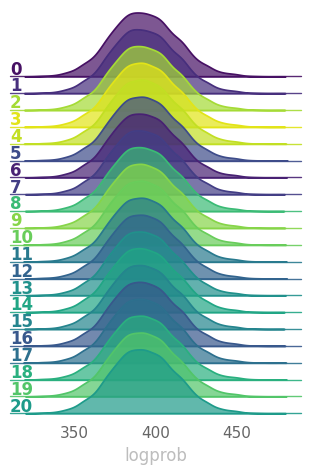

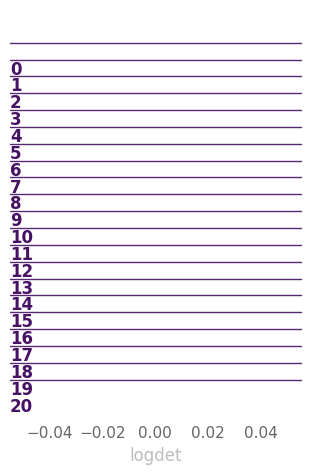

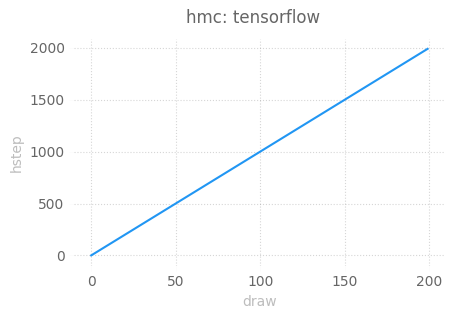

...

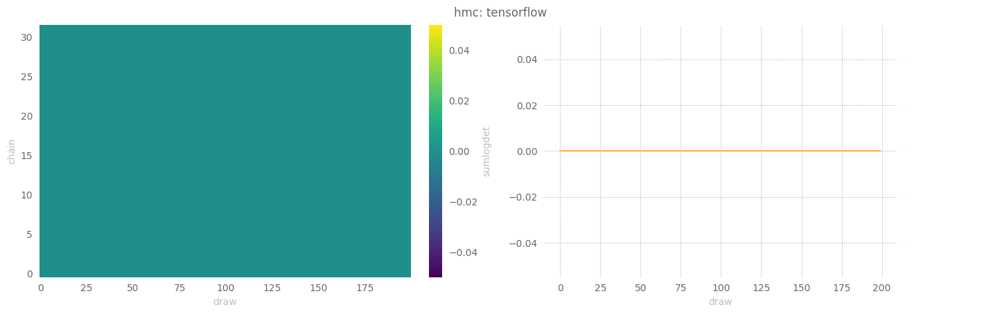

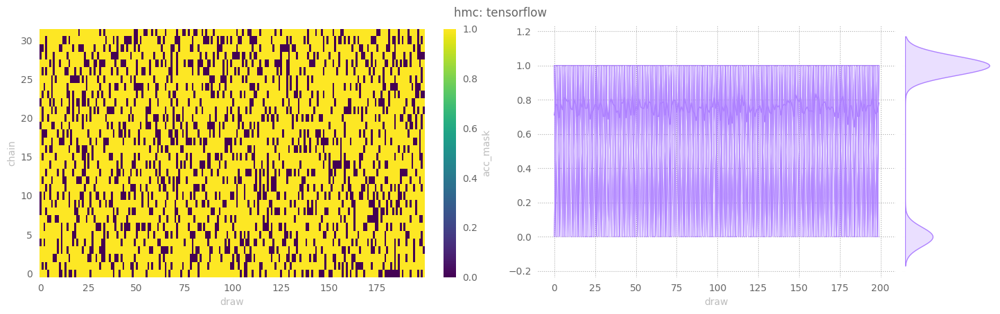

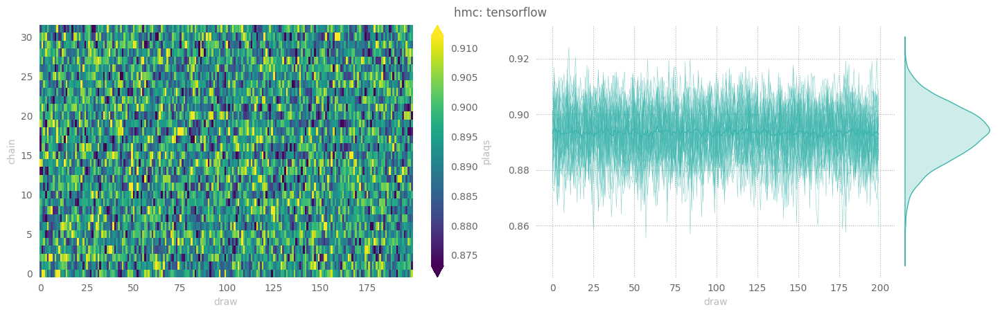

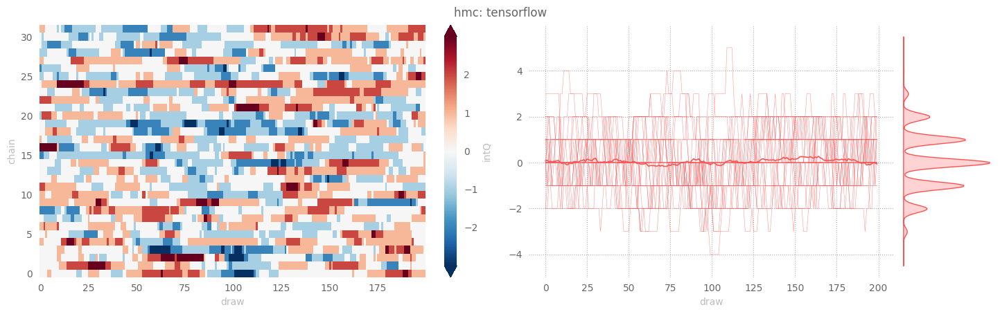

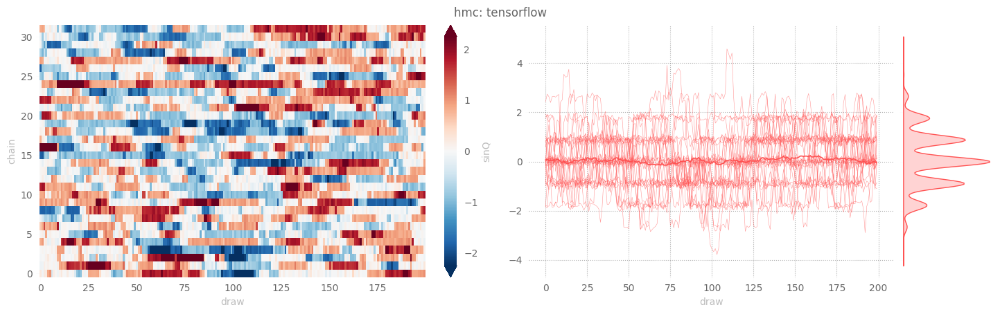

In [12]:
outputs['tensorflow']['hmc'] = tfExpU1.trainer.eval(
    job_type='hmc',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)
_ = tfExpU1.save_dataset(job_type='hmc', nchains=32)

# Model Performance

Our goal is improving the efficiency of our MCMC sampler.

In particular, we are interested in generating **independent** save_datasetrations which we can then use to calculate expectation values of physical observables.

For our purposes, we are interested in obtaining lattice configurations from distinct _topological charge sectors_, as characterized by a configurations _topological charge_, $Q$.

HMC is known to suffer from _critical slowing down_, a phenomenon in which our configurations remains stuck in some local topological charge sector and fails to produce distinct configurations.

In particular, it is known that the integrated autocorrelation time of the topological charge $\tau$ grows exponentially with decreasing lattice spacing (i.e. continuum limit), making this theory especially problematic.

Because of this, we can assess our models' performance by looking at the _tunneling rate_, i.e. the rate at which our sampler jumps between these different charge sectors.

We can write this quantity as:

$$
\delta Q = |Q^{(i)} - Q^{(i-1)}|
$$

where we look at the difference in the topological charge between sequential configurations.

<div class="alert alert-block alert-info" style="background:rgba(34,139,230,0.1); color: rgb(34,139,230); border: 0px solid; border-radius:5px;">
<b>Note:</b> 
The efficiency of our sampler is directly proportional to the tunneling rate, which is inversely proportional to the integrated autocorrelation time $\tau$, i.e.

&nbsp;

$$
\text{Efficiency} \propto \delta Q \propto \frac{1}{\tau}
$$

Explicitly, this means that the **more efficient** the model $\longrightarrow$

- the **larger** tunneling rate
- the **smaller** integrated autocorrelation time for $Q$
</div>

In [13]:
import xarray as xr

def get_thermalized_configs(
        x: np.ndarray | xr.DataArray,
        drop: int = 5
) -> np.ndarray | xr.DataArray:
    """Drop the first `drop` states across all chains.

    x.shape = [draws, chains]
    """
    if isinstance(x, np.ndarray):
        return np.sort(x)[..., :-drop]
    if isinstance(x, xr.DataArray):
        return x.sortby(
            ['chain', 'draw'],
            ascending=False
        )[..., :-drop]
    raise TypeError

# Comparisons

We can measure our models' performance explicitly by looking at the average tunneling rate, $\delta Q_{\mathbb{Z}}$, for our **trained model** and comparing it against generic HMC.

Recall,

$$\delta Q_{\mathbb{Z}} := \big|Q^{(i+1)}_{\mathbb{Z}} - Q^{(i)}_{\mathbb{Z}}\big|$$

where a **higher** value of $\delta Q_{\mathbb{Z}}$ corresponds to **better** tunneling of the topological charge, $Q_{\mathbb{Z}}$.

Note that we can get a concise representation of the data from different parts of our run via:

Note that the data from each of the different parts of our experiment (i.e. `train`, `eval`, and `hmc`) are stored as a dict, e.g.

```python
>>> list(ptExpU1.trainer.histories.keys())
['train', 'eval', 'hmc']
>>> train_history = ptExpU1.trainer.histories['train']
>>> train_dset = train_history.get_dataset()
>>> assert isinstance(train_history, l2hmc.utils.history.BaseHistory)
>>> assert isinstance(train_dset, xarray.Dataset)
```

(see below, for example)

We aggregate the data into the `dsets` dict below, grouped by:

1. **Framework** (`pytorch` / `tensorflow`)
2. **Job type** (`train`, `eval`, `hmc`)

In [14]:
import logging
log = logging.getLogger(__name__)
dsets = {}
fws = ['pt', 'tf']
modes = ['train', 'eval', 'hmc']
for fw in fws:
    dsets[fw] = {}
    for mode in modes:
        hist = None
        if fw == 'pt':
            hist = ptExpU1.trainer.histories.get(mode, None)
        elif fw == 'tf':
            hist = tfExpU1.trainer.histories.get(mode, None)
        if hist is not None:
            log.info(f'Getting dataset for {fw}: {mode}')
            dsets[fw][mode] = hist.get_dataset()

[15:02:58] INFO     Getting dataset for pt: train

[15:02:00] INFO     Getting dataset for pt: eval

           INFO     Getting dataset for pt: hmc

           INFO     Getting dataset for tf: train

           INFO     Getting dataset for tf: eval

           INFO     Getting dataset for tf: hmc

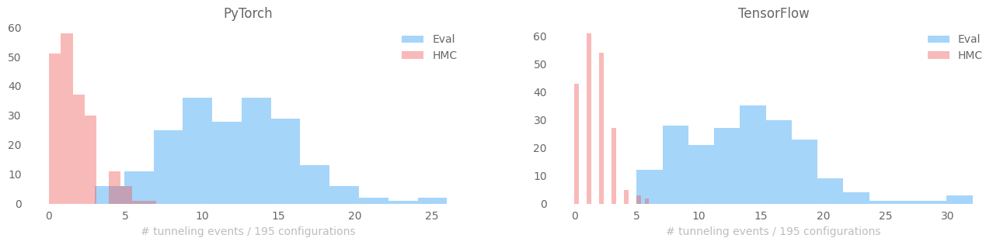

In [15]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['text.usetex'] = False
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import COLORS, set_plot_style

set_plot_style()

fig, ax = plt.subplots(figsize=(16, 3), ncols=2)

# ---------------------------------------------
# ---- DROP FIRST 20% FOR THERMALIZATION ------
# ---------------------------------------------
KEEP = int(0.8 * len(dsets['tf']['eval'].draw))
dqpte = get_thermalized_configs(dsets['pt']['eval']['dQint'].astype('int'))
dqpth = get_thermalized_configs(dsets['pt']['hmc']['dQint'].astype('int'))

dqtfe = get_thermalized_configs(dsets['tf']['eval']['dQint'].astype('int'))
dqtfh = get_thermalized_configs(dsets['tf']['hmc']['dQint'].astype('int'))

_ = sns.distplot(
    dqpte.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[0]
)
_ = sns.distplot(
    dqpth.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[0]
)

_ = ax[0].set_title('PyTorch')
_ = ax[0].set_xlabel(
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[0].legend(loc='best', frameon=False)
plt.legend()

_ = sns.distplot(
    dqtfe.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[1]
)
_ = sns.distplot(
    dqtfh.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[1]
)

_ = ax[1].set_title('TensorFlow')
_ = ax[1].set_xlabel(
    #r"""$\sum_{i=0} \left|\delta Q_{i}\right|$""",
    #fontsize='large',
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[1].legend(loc='best', frameon=False)

## TensorFlow Results

In [16]:
import rich

[15:02:01] INFO     TensorFlow, EVAL                                                         
                     dQint.sum('chain'):                                                     
                     <xarray.DataArray 'dQint' (draw: 90)>                                   
                    array([ 5, 21, 14, 15, 20, 15,  9,  7, 20, 22, 10, 20, 17, 18, 16, 18,   
                    9,                                                                       
                           18, 15, 12, 11, 18, 10, 15, 17, 16, 14, 19, 13, 10, 15, 14, 16,   
                    18,                                                                      
                           14, 18,  9, 12, 30, 17,  7, 17, 31,  8, 13, 18, 21, 14, 14, 19,   
                    11,                                                                      
                           13, 16,  5, 12, 17,  9,  9, 10, 32, 12, 11, 22, 18,  7, 16, 14,   
                    12,                                                                      
                           14, 10, 12, 15, 19, 18, 12, 17, 13, 18, 19, 12, 24,  8, 13, 16,   
                    8,                                                                       
                           16, 17, 14, 10,  9])                                              
                    Coordinates:                                                             
                      * draw     (draw) int64 110 111 112 113 114 115 ... 194 195 196 197 198
                    199

           INFO     dQint.sum(): <xarray.DataArray 'dQint' ()>                               
                    array(1329)

           INFO     TensorFlow, HMC                                                          
                     dQint.sum('chain'):                                                     
                     <xarray.DataArray 'dQint' (draw: 90)>                                   
                    array([2, 1, 0, 3, 2, 2, 0, 2, 1, 2, 1, 1, 0, 1, 2, 0, 0, 2, 3, 2, 6, 1, 
                           1, 2, 1, 1, 2, 2, 1, 1, 2, 2, 1, 3, 3, 2, 0, 0, 0, 1, 2, 0, 1, 3, 
                           1, 0, 0, 1, 2, 2, 2, 2, 0, 0, 3, 6, 1, 2, 0, 0, 1, 2, 1, 3, 1, 3, 
                           2, 3, 1, 2, 1, 0, 4, 3, 1, 1, 2, 2, 1, 3, 1, 1, 3, 0, 0, 1, 2, 0, 
                           2, 1])                                                            
                    Coordinates:                                                             
                      * draw     (draw) int64 110 111 112 113 114 115 ... 194 195 196 197 198
                    199

           INFO     dQint.sum(): <xarray.DataArray 'dQint' ()>                               
                    array(135)

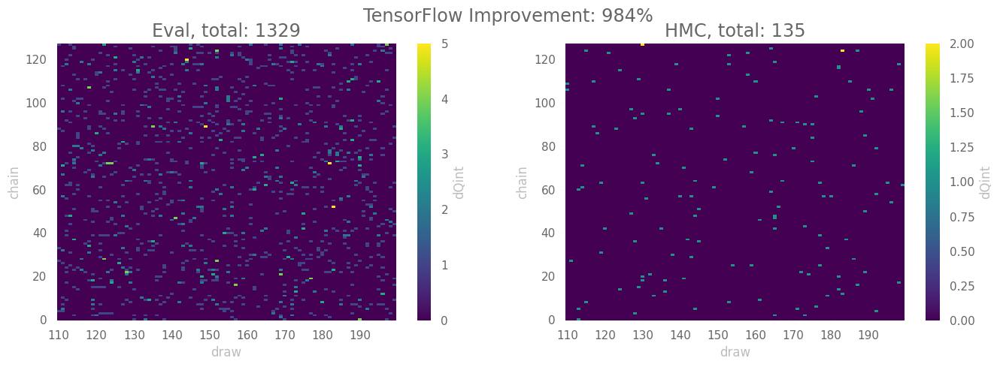

In [17]:
sns.set_context('notebook')
ndraws = len(dsets['tf']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['tf']['eval']['dQint'][:, -90:]
dqh = dsets['tf']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'TensorFlow Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

log.info(f"TensorFlow, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T}")
log.info(f"dQint.sum(): {dqe.astype(int).sum().T}")
log.info(f"TensorFlow, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T}")
log.info(f"dQint.sum(): {dqh.astype(int).sum().T}")

### PyTorch Results

[15:02:02] INFO     ------------------------------------------------------------

           INFO     PyTorch, EVAL                                                            
                     dQint.sum('chain'):                                                     
                     [11 15 13 16 17 23 14 14 13  8 16  7 11  8 16  9 11  9 10 11 13 10 20 13
                      9 14 16 12 15  9 13  4  9  5  7 11 11 17 15 17 13 10 12  9 15  3  8 10 
                     18 11 20  8  3 14  8  9  7  9 13 17  8  9 16 14 15 15  9  8  7  9  9 16 
                     15  7 11 12 11 19 18  6 10  6 10 11 22  4 14 15 11  6]

           INFO     dQint.sum(): 1052

           INFO     ------------------------------------------------------------

           INFO     PyTorch, HMC                                                             
                     dQint.sum('chain'):                                                     
                     [0 1 0 0 3 3 2 1 2 4 2 5 3 3 0 3 0 0 1 0 0 0 0 0 2 2 0 0 1 1 3 3 1 1 4 5
                    1                                                                        
                     0 2 2 4 2 2 1 0 1 5 2 1 2 1 3 2 1 3 1 3 1 3 3 3 0 4 4 3 2 1 5 1 0 2 2 4 
                    3                                                                        
                     2 0 0 4 1 4 2 2 0 0 2 0 1 1 3 1]

           INFO     dQint.sum(): 159

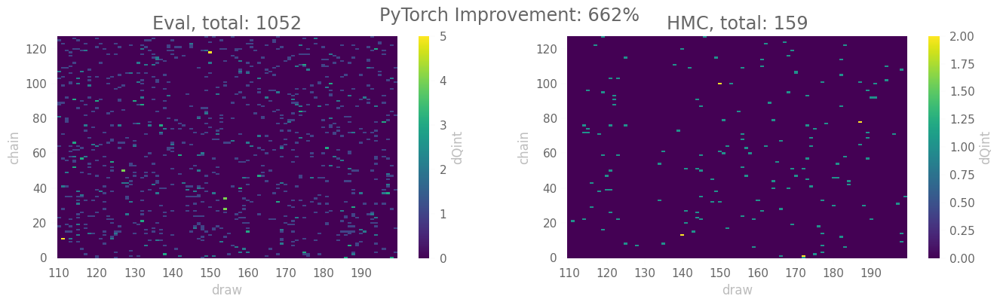

In [18]:
sns.set_context('notebook')
ndraws = len(dsets['pt']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['pt']['eval']['dQint'][:, -90:]
dqh = dsets['pt']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], 0.8 * fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'PyTorch Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

log.info(60 * '-')
log.info(f"PyTorch, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T.values}")
log.info(f"dQint.sum(): {dqe.astype(int).sum().T.values}")
log.info(60 * '-')
log.info(f"PyTorch, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T.values}")
log.info(f"dQint.sum(): {dqh.astype(int).sum().T.values}")

## Comparisons

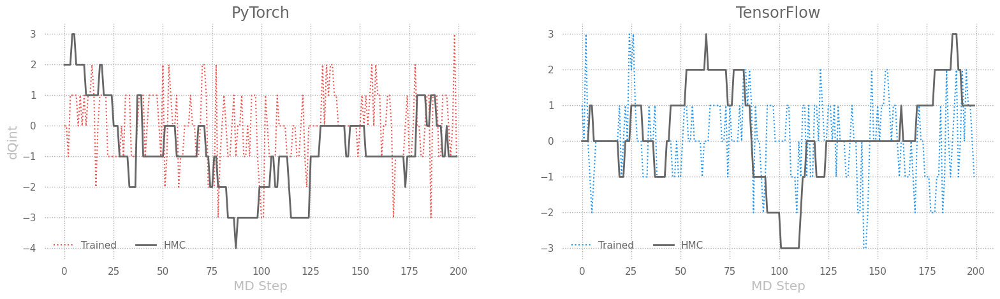

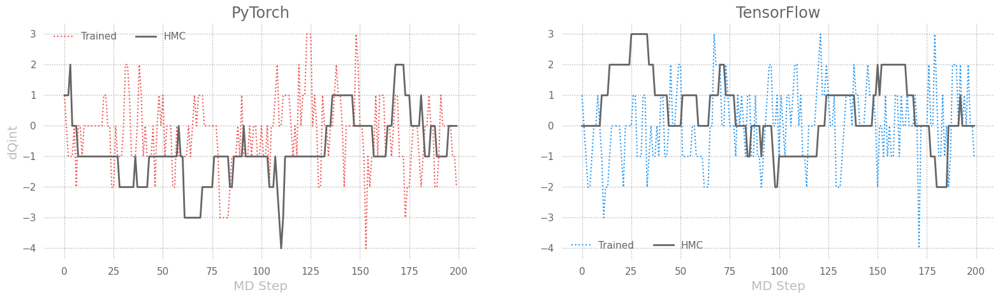

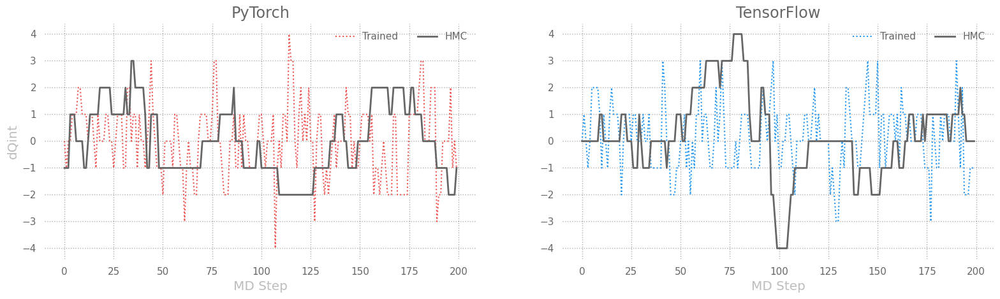

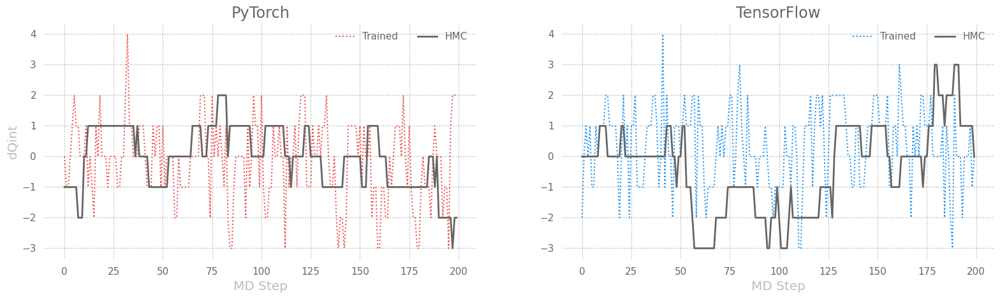

In [19]:
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import set_plot_style, COLORS

import seaborn as sns
set_plot_style()
plt.rcParams['axes.linewidth'] = 2.0
sns.set_context('notebook')
figsize = plt.rcParamsDefault['figure.figsize']
plt.rcParams['figure.dpi'] = plt.rcParamsDefault['figure.dpi']

for idx in range(4):
    fig, (ax, ax1) = plt.subplots(
        ncols=2,
        #nrows=4,
        figsize=(3. * figsize[0], figsize[1]),
    )
    _ = ax.plot(
        dsets['pt']['eval'].intQ[idx],  # .dQint.mean('chain')[100:],
        color=COLORS['red'],
        ls=':',
        label='Trained',
        lw=1.5,
    );

    _ = ax.plot(
        dsets['pt']['hmc'].intQ[idx],  # .dQint.mean('chain')[100:],
        ls='-',
        label='HMC',
        color='#666666',
        zorder=5,
        lw=2.0,
    );

    _ = ax1.plot(
        dsets['tf']['eval'].intQ[idx],  # .dQint.mean('chain')[-100:],
        color=COLORS['blue'],
        ls=':',
        label='Trained',
        lw=1.5,

    );
    _ = ax1.plot(
        dsets['tf']['hmc'].intQ[idx],  # .dQint.mean('chain')[-100:],
        color='#666666',
        ls='-',
        label='HMC',
        zorder=5,
        lw=2.0,
    );
    _ = ax.set_title('PyTorch', fontsize='x-large')
    _ = ax1.set_title('TensorFlow', fontsize='x-large')
    #_ = ax1.set_ylim(ax.get_ylim())
    _ = ax.grid(True, alpha=0.4)
    _ = ax1.grid(True, alpha=0.4)
    _ = ax.set_xlabel('MD Step', fontsize='large')
    _ = ax1.set_xlabel('MD Step', fontsize='large')
    _ = ax.set_ylabel('dQint', fontsize='large')
    _ = ax.legend(loc='best', framealpha=0.0, ncol=2, labelcolor='#666666')
    _ = ax1.legend(loc='best', framealpha=0.0, ncol=2, labelcolor='#666666')